In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
#from pmdarima.arima import auto_arima
from math import sqrt
from sklearn.metrics import mean_squared_error
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.stattools import adfuller
import statsmodels.tsa.stattools as tsa
from numpy import log

In [2]:
# ORTHO-EAST

df_desc = pd.read_csv("data/alqueva_calibrated_asc_desc_2019_2023/EGMS_L2b_052_0848_IW2_VV_2019_2023_1/EGMS_L2b_052_0848_IW2_VV_2019_2023_1.csv")
df_asc = pd.read_csv("data/alqueva_calibrated_asc_desc_2019_2023/EGMS_L2b_147_0224_IW2_VV_2019_2023_1/EGMS_L2b_147_0224_IW2_VV_2019_2023_1.csv")

In [3]:
df_desc

,pid,mp_type,latitude,longitude,easting,northing,height,height_wgs84,line,pixel,...,20230904,20230916,20230928,20231010,20231022,20231103,20231115,20231127,20231209,20231221
0,4EM4h00p9W,0,38.287821,-7.313548,2810422.31,1861750.76,185.5,240.7,3,26,...,-10.4,-12.2,-10.6,-6.5,-10.7,1.6,-4.4,-7.8,-0.5,-17.6
1,4EM4h00H9R,0,38.290389,-7.329765,2809092.57,1862351.02,178.6,233.8,1,397,...,-12.7,-8.1,-8.7,-4.5,-12.2,-12.5,-10.8,-10.0,-10.1,-6.9
2,4EM4h00H9S,0,38.290388,-7.329755,2809093.37,1862350.68,175.1,230.3,1,398,...,-8.8,-4.9,-5.9,-0.8,-9.0,-11.0,-5.0,0.8,-5.5,-6.4
3,4EM4h01NLc,0,38.289922,-7.330067,2809056.21,1862306.38,182.3,237.5,5,400,...,-12.2,-14.1,-2.1,-14.7,-19.3,-9.0,-10.3,-13.7,-14.0,-9.4
4,4EM4h016Ks,0,38.290941,-7.336324,2808543.82,1862541.14,184.0,239.2,4,542,...,13.4,1.5,5.5,5.0,3.9,4.8,4.5,4.6,0.3,1.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
226440,4EM4h6WqMM,0,38.205181,-8.062672,2744485.21,1868003.83,99.4,154.3,1472,16794,...,-9.0,-10.6,-11.6,-10.0,-11.0,-11.7,-8.9,-10.2,-10.4,-9.1
226441,4EM4h6WqMO,0,38.205202,-8.062822,2744472.87,1868009.15,104.5,159.4,1472,16796,...,-8.4,-9.0,-6.7,-6.1,-10.9,-12.7,-10.3,-10.9,-11.6,-11.7
226442,4EM4h6WZJz,0,38.205539,-8.064358,2744349.51,1868077.46,103.0,157.9,1471,16835,...,-4.3,-4.4,-6.1,-5.9,-1.8,0.3,-1.9,2.9,6.9,1.4
226443,4EM4h6WqN0,0,38.205420,-8.064419,2744341.53,1868065.84,108.6,163.5,1472,16834,...,-0.6,0.4,-4.5,-1.0,1.8,7.7,0.4,7.5,6.7,5.3


In [4]:
df_asc

,pid,mp_type,latitude,longitude,easting,northing,height,height_wgs84,line,pixel,...,20230829,20230910,20230922,20231004,20231016,20231109,20231121,20231203,20231215,20231227
0,4eR7j0000B,4549,38.027594,-7.743627,2767688.47,1842235.70,174.7,229.7,0,11,...,19.9,18.2,19.1,19.4,17.7,19.4,17.9,23.0,22.1,19.7
1,4eR7j0000N,0,38.027671,-7.743092,2767736.11,1842233.08,175.2,230.2,0,23,...,-2.1,-0.4,5.1,3.3,0.2,13.1,8.3,-10.3,10.0,-9.2
2,4eR7j0000Q,0,38.027682,-7.743014,2767743.09,1842232.70,171.7,226.7,0,26,...,12.5,10.2,11.0,11.0,12.6,11.6,14.3,17.8,6.8,4.0
3,4eR7j0000a,0,38.027750,-7.742540,2767785.28,1842230.38,173.9,228.9,0,36,...,-2.4,-14.1,-2.4,-0.2,5.3,-4.2,1.8,-5.3,7.1,2.8
4,4eR7j0000d,0,38.027771,-7.742393,2767798.35,1842229.66,174.8,229.8,0,39,...,-3.8,-10.3,-7.0,-1.6,3.0,-3.4,6.2,5.6,1.1,3.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1186521,4eR7j6TIhB,0,38.348657,-6.767709,2858485.49,1857681.54,534.5,590.0,1459,24373,...,-6.6,-6.6,-5.1,-6.0,-5.4,-1.3,-6.6,-5.2,-5.5,-3.6
1186522,4eR7j6TIhC,0,38.348656,-6.767715,2858484.88,1857681.57,530.9,586.3,1459,24374,...,-5.6,-5.8,-7.2,-4.0,-2.8,-8.6,-7.5,-7.0,-6.2,-2.4
1186523,4eR7j6T1eZ,0,38.348671,-6.766654,2858576.08,1857662.77,534.7,590.1,1458,24399,...,-5.2,-7.1,-11.6,-7.9,-8.7,6.9,3.0,-11.4,12.4,-11.3
1186524,4eR7j6TIha,0,38.348783,-6.766771,2858568.53,1857677.12,530.8,586.2,1459,24398,...,-11.6,-8.9,-13.7,-10.4,-9.7,-4.4,-0.7,-9.0,-10.1,-3.1


In [5]:
# Pega os nomes das primeiras 25 colunas
colunas_desc = df_desc.columns[:24]

# Mostra os nomes
print(colunas_desc)

Index(['pid', 'mp_type', 'latitude', 'longitude', 'easting', 'northing',
       'height', 'height_wgs84', 'line', 'pixel', 'rmse', 'temporal_coherence',
       'amplitude_dispersion', 'incidence_angle', 'track_angle', 'los_east',
       'los_north', 'los_up', 'mean_velocity', 'mean_velocity_std',
       'acceleration', 'acceleration_std', 'seasonality', 'seasonality_std'],
      dtype='object')


In [6]:
# Pega os nomes das primeiras 25 colunas
colunas_asc = df_asc.columns[:24]

# Mostra os nomes
print(colunas_asc)

Index(['pid', 'mp_type', 'latitude', 'longitude', 'easting', 'northing',
       'height', 'height_wgs84', 'line', 'pixel', 'rmse', 'temporal_coherence',
       'amplitude_dispersion', 'incidence_angle', 'track_angle', 'los_east',
       'los_north', 'los_up', 'mean_velocity', 'mean_velocity_std',
       'acceleration', 'acceleration_std', 'seasonality', 'seasonality_std'],
      dtype='object')


In [5]:
# Definir os limites Alqueva
norte_min = 1855050
norte_max = 1855850
este_min = 2792250
este_max = 2793250

# Aplicar o filtro
df_desc = df_desc[
    (df_desc['northing'] >= norte_min) & (df_desc['northing'] <= norte_max) &
    (df_desc['easting'] >= este_min) & (df_desc['easting'] <= este_max)
]

df_desc

,pid,mp_type,latitude,longitude,easting,northing,height,height_wgs84,line,pixel,...,20230904,20230916,20230928,20231010,20231022,20231103,20231115,20231127,20231209,20231221
129276,4EM4h3zlyc,0,38.198409,-7.490936,2793227.41,1855609.57,152.2,207.3,901,3506,...,-2.0,8.7,4.3,4.7,-6.3,-0.7,2.6,-1.7,-1.8,-6.8
129277,4EM4h40sB8,0,38.198063,-7.492095,2793120.35,1855595.34,152.6,207.8,905,3530,...,-8.4,3.3,-1.0,-0.1,0.6,-6.3,-16.4,5.7,-3.4,-6.5
129278,4EM4h40sB9,0,38.198071,-7.492150,2793115.82,1855597.28,153.4,208.6,905,3531,...,-7.5,-8.0,-1.9,-2.8,-0.3,-6.0,-2.4,-6.3,-10.0,-13.1
129279,4EM4h40sBK,0,38.198140,-7.492641,2793075.38,1855614.65,154.4,209.5,905,3542,...,-12.1,-11.8,-17.2,-6.6,-15.5,-6.9,-11.4,-11.2,-24.9,-2.9
129280,4EM4h40sBN,0,38.198159,-7.492773,2793064.49,1855619.33,154.5,209.7,905,3545,...,-12.1,-7.7,-10.8,-6.3,-5.9,-9.0,-8.1,-7.3,-14.0,-7.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144120,4EM4h4FAlN,0,38.192575,-7.500200,2792302.25,1855163.93,135.5,190.7,957,3689,...,-1.4,-5.1,-4.1,-7.7,-4.6,-4.3,-6.6,-7.2,-10.3,1.5
144121,4EM4h4FRnx,5896,38.192272,-7.498961,2792401.47,1855106.26,131.7,186.8,958,3661,...,-11.9,-12.5,-13.0,-11.1,-11.9,-15.3,-13.9,-16.9,-16.8,-16.5
144122,4EM4h4FRo2,7461,38.192307,-7.499206,2792381.29,1855114.92,133.6,188.8,958,3666,...,-4.9,-6.3,-6.5,-4.6,-7.3,-11.7,-11.5,-12.4,-14.9,-11.6
144125,4EM4h4FAla,0,38.192655,-7.500768,2792255.44,1855184.04,135.9,191.1,957,3702,...,-9.8,-12.0,-4.8,-3.0,-10.3,-4.8,-14.3,5.2,-16.2,-14.6


In [6]:
# Definir os limites Alqueva
norte_min = 1855050
norte_max = 1855850
este_min = 2792250
este_max = 2793250

# Aplicar o filtro
df_asc = df_asc[
    (df_asc['northing'] >= norte_min) & (df_asc['northing'] <= norte_max) &
    (df_asc['easting'] >= este_min) & (df_asc['easting'] <= este_max)
]

df_asc

,pid,mp_type,latitude,longitude,easting,northing,height,height_wgs84,line,pixel,...,20230829,20230910,20230922,20231004,20231016,20231109,20231121,20231203,20231215,20231227
821977,4eR7j4UrEJ,5072,38.191540,-7.500285,2792271.61,1855053.61,160.7,215.9,1014,6299,...,18.3,14.1,11.6,14.4,9.8,11.6,15.3,14.7,13.8,10.4
821979,4eR7j4VPKX,5438,38.191826,-7.500066,2792296.77,1855080.18,150.2,205.4,1016,6309,...,3.4,3.6,3.5,2.0,2.5,7.4,6.2,8.9,8.1,7.1
821980,4eR7j4VPKg,7007,38.191869,-7.499765,2792323.55,1855078.72,144.5,199.7,1016,6318,...,-6.5,7.3,6.5,2.9,-0.5,-17.4,-19.7,5.4,-12.2,-13.3
821981,4eR7j4VgNi,7164,38.191990,-7.499813,2792322.13,1855092.77,143.1,198.3,1017,6318,...,-9.9,-1.6,2.5,4.0,-7.0,-19.7,-20.1,-0.3,-9.1,-14.5
821983,4eR7j4VPLW,6379,38.192143,-7.497819,2792496.35,1855069.28,125.7,180.9,1016,6370,...,-19.4,-15.7,-18.1,-22.6,-23.1,-21.0,-28.5,-30.3,-20.6,-23.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
866039,4eR7j4ibg9,0,38.197814,-7.501022,2792350.48,1855747.63,166.1,221.3,1064,6313,...,4.2,4.3,8.2,9.6,8.6,16.6,8.3,13.3,16.8,-2.1
866040,4eR7j4isj5,0,38.197909,-7.501258,2792332.40,1855762.58,169.4,224.6,1065,6307,...,0.8,12.4,14.7,-1.4,5.9,10.9,5.8,10.7,12.5,13.4
866041,4eR7j4isj6,0,38.197911,-7.501242,2792333.82,1855762.51,167.6,222.8,1065,6308,...,2.2,12.3,15.1,3.3,7.4,10.0,5.0,10.6,10.5,12.6
866042,4eR7j4j9m7,0,38.198029,-7.501305,2792331.09,1855776.62,168.1,223.3,1066,6307,...,0.8,12.7,16.5,-5.2,9.2,8.6,9.9,13.0,11.9,12.9


# 🎯 Objetivo Final
- Transformar os deslocamentos LOS (line-of-sight) dos datasets ascending e descending para obter:

- Deslocamento Leste-Oeste (East)

- eslocamento Norte-Sul (North)

- Deslocamento Vertical (Up/Down)

- E depois fundir os dois conjuntos mesmo que os pontos não coincidam, para ter um campo vetorial completo.

# 📦 Datasets: df_asc e df_desc

## Cada dataset tem:

- 25 colunas iniciais fixas com metadados

- A partir da coluna 26, datas como colunas, com os deslocamentos LOS

- Colunas importantes: 'los_east', 'los_north', 'los_up' → componentes unitários do vetor LOS

# ✅ Etapa 1: Decompor deslocamentos LOS em componentes ENU (East, North, Up)

## Função

In [7]:
import pandas as pd

def calcular_componentes_enu(displacements, los_vectors):
    """
    Transforma deslocamentos LOS em componentes East, North, Up
    - displacements: DataFrame com deslocamentos LOS (colunas = datas)
    - los_vectors: ndarray (n x 3) com [los_east, los_north, los_up]
    Retorna: 3 DataFrames: east, north, up
    """
    east = pd.DataFrame(index=displacements.index)
    north = pd.DataFrame(index=displacements.index)
    up = pd.DataFrame(index=displacements.index)

    for date in displacements.columns:
        d_los = displacements[date].values
        east[date] = d_los * los_vectors[:, 0]
        north[date] = d_los * los_vectors[:, 1]
        up[date] = d_los * los_vectors[:, 2]

    return east, north, up


## Aplicação

In [8]:
# Separar deslocamentos
n_colunas_fixas = 25
asc_disp = df_asc.iloc[:, n_colunas_fixas:]
desc_disp = df_desc.iloc[:, n_colunas_fixas:]

# Extrair vetores LOS
asc_los = df_asc[['los_east', 'los_north', 'los_up']].values
desc_los = df_desc[['los_east', 'los_north', 'los_up']].values

# Converter para ENU
asc_east, asc_north, asc_up = calcular_componentes_enu(asc_disp, asc_los)
desc_east, desc_north, desc_up = calcular_componentes_enu(desc_disp, desc_los)


C:\Users\tiago\AppData\Local\Temp\ipykernel_2420\3579718616.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  east[date] = d_los * los_vectors[:, 0]
C:\Users\tiago\AppData\Local\Temp\ipykernel_2420\3579718616.py:17: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  north[date] = d_los * los_vectors[:, 1]
C:\Users\tiago\AppData\Local\Temp\ipykernel_2420\3579718616.py:18: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joinin

# 🚧 Etapa 2: Fusão dos dois datasets

## 🔁 Opção A — Interpolação Espacial

### Interpolar os pontos desc para a localização dos pontos asc e fazer a média:

In [9]:
from scipy.interpolate import griddata
import numpy as np

def interpolar_componentes(desc_component, df_desc, df_asc):
    """
    Interpola um componente do df_desc para os pontos do df_asc
    """
    pontos_desc = df_desc[['easting', 'northing']].values
    pontos_asc = df_asc[['easting', 'northing']].values

    interpolado = pd.DataFrame(index=df_asc.index)

    for date in desc_component.columns:
        valores = desc_component[date].values
        interp = griddata(pontos_desc, valores, pontos_asc, method='linear')
        interpolado[date] = interp

    return interpolado


## Aplicação

In [10]:
# Interpolação
desc_east_interp = interpolar_componentes(desc_east, df_desc, df_asc)
desc_north_interp = interpolar_componentes(desc_north, df_desc, df_asc)
desc_up_interp = interpolar_componentes(desc_up, df_desc, df_asc)

# Fusão (média simples dos dois)
east_fusion = (asc_east + desc_east_interp) / 2
north_fusion = (asc_north + desc_north_interp) / 2
up_fusion = (asc_up + desc_up_interp) / 2


C:\Users\tiago\AppData\Local\Temp\ipykernel_2420\4213071866.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolado[date] = interp
C:\Users\tiago\AppData\Local\Temp\ipykernel_2420\4213071866.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  interpolado[date] = interp
C:\Users\tiago\AppData\Local\Temp\ipykernel_2420\4213071866.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once usi

# 📊 Etapa 3: Visualização simples

## Exemplo 1 — Gráfico de linha dos deslocamentos médios:

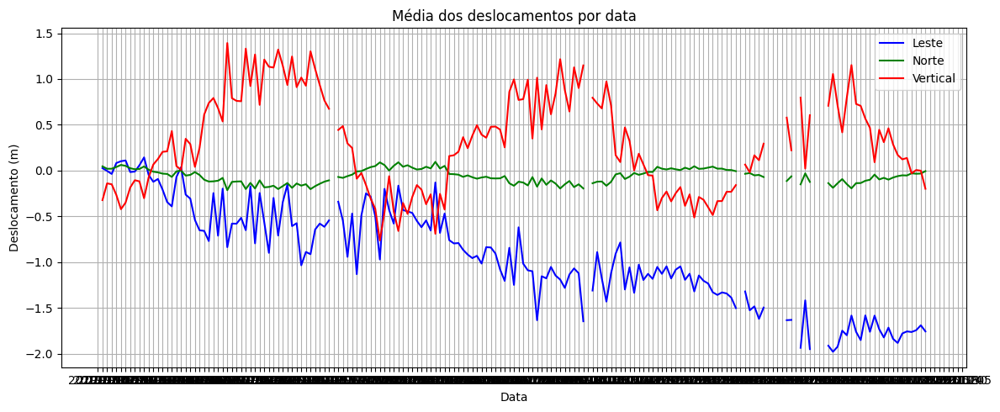

In [11]:
import matplotlib.pyplot as plt

# Deslocamento médio no tempo (só para exemplo)
east_mean = east_fusion.mean()
north_mean = north_fusion.mean()
up_mean = up_fusion.mean()

plt.figure(figsize=(12, 5))
plt.plot(east_mean, label='Leste', color='blue')
plt.plot(north_mean, label='Norte', color='green')
plt.plot(up_mean, label='Vertical', color='red')
plt.legend()
plt.title("Média dos deslocamentos por data")
plt.xlabel("Data")
plt.ylabel("Deslocamento (m)")
plt.grid()
plt.tight_layout()
plt.show()


C:\Users\tiago\AppData\Local\Temp\ipykernel_2420\499608650.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asc[f"mean_{nome_componente}"] = componente.mean(axis=1)


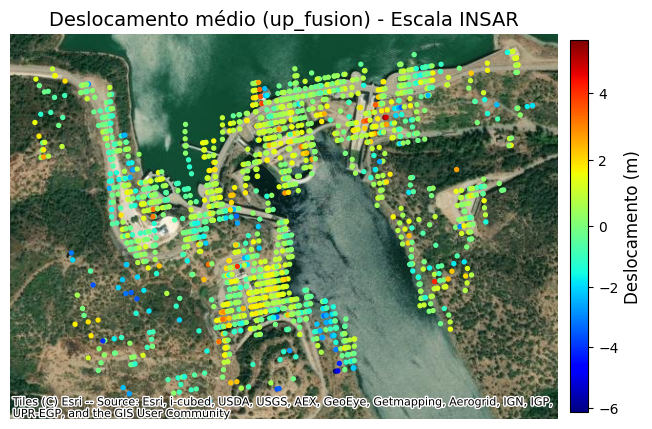

In [12]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib.cm import ScalarMappable
import contextily as ctx

# === CONFIGURAÇÃO ===
# Componente a visualizar (ex: up_fusion, east_fusion, north_fusion)
componente = up_fusion  # troca aqui se quiseres outro
nome_componente = "up_fusion"

# Adiciona média da série temporal ao DataFrame original
df_asc[f"mean_{nome_componente}"] = componente.mean(axis=1)

# === CRIAÇÃO DO GDF ===
gdf = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"  # ou outro se o teu CRS for diferente
)
gdf_web = gdf.to_crs(epsg=3857)

# === ESCALA DE CORES ===
# Usar colormap típico de INSAR
coluna_valor = f"mean_{nome_componente}"
cmap = plt.colormaps.get_cmap('jet')  # clássico INSAR

# Escala centrada no zero
norma = colors.TwoSlopeNorm(
    vmin=gdf_web[coluna_valor].min(),
    vcenter=0,
    vmax=gdf_web[coluna_valor].max()
)

# === PLOT ===
fig, ax = plt.subplots(figsize=(8, 5))
gdf_web.plot(
    ax=ax,
    column=coluna_valor,
    cmap=cmap,
    markersize=8,
    norm=norma,
    legend=False
)

ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)
ax.set_axis_off()
plt.title(f"Deslocamento médio ({nome_componente}) - Escala INSAR", fontsize=14)

# Barra de cores
sm = ScalarMappable(cmap=cmap, norm=norma)
sm._A = []
cbar = plt.colorbar(sm, ax=ax, fraction=0.03, pad=0.02)
cbar.set_label("Deslocamento (m)", fontsize=12)

plt.show()


In [13]:
import numpy as np
from tslearn.preprocessing import TimeSeriesScalerMeanVariance
from tslearn.clustering import TimeSeriesKMeans

# Original
serie_temporal = up_fusion.values

# Filtrar séries válidas
mask_validas = ~np.isnan(serie_temporal).all(axis=1)
serie_temporal_filtrada = serie_temporal[mask_validas]

# Normalizar
scaler = TimeSeriesScalerMeanVariance()
serie_normalizada = scaler.fit_transform(serie_temporal_filtrada)

# Clustering
n_clusters = 5
modelo = TimeSeriesKMeans(n_clusters=n_clusters, metric="dtw", random_state=0)
labels = modelo.fit_predict(serie_normalizada)

# Mapear para o GeoDataFrame completo
labels_full = -1 * np.ones(serie_temporal.shape[0], dtype=int)
labels_full[mask_validas] = labels
gdf["cluster"] = labels_full



c:\Users\tiago\OneDrive\01_phd\projetos\python\hst\venv\lib\site-packages\tslearn\bases\bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)
c:\Users\tiago\OneDrive\01_phd\projetos\python\hst\venv\lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\tiago\OneDrive\01_phd\projetos\python\hst\venv\lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\tiago\OneDrive\01_phd\projetos\python\hst\venv\lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\tiago\OneDrive\01_phd\projetos\python\hst\venv\lib\site-pac

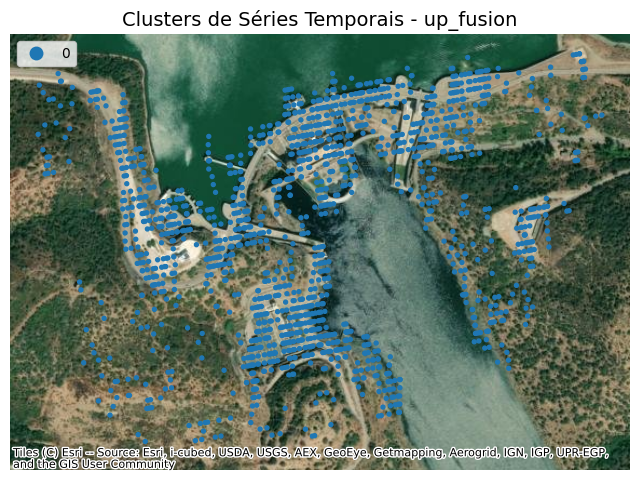

In [14]:
import matplotlib.pyplot as plt
import contextily as ctx

# Primeiro, reprojetar para web mercator se ainda não fez
gdf_web = gdf.to_crs(epsg=3857)

# Fazer o plot
fig, ax = plt.subplots(figsize=(8, 6))
gdf_web[gdf_web["cluster"] != -1].plot(
    ax=ax,
    column="cluster",
    cmap="tab10",  # paleta de cores para clusters
    markersize=8,
    legend=True,
    categorical=True
)

# Adicionar o basemap
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)

# Estilizar
ax.set_axis_off()
plt.title(f"Clusters de Séries Temporais - {nome_componente}", fontsize=14)
plt.show()


C:\Users\tiago\AppData\Local\Temp\ipykernel_19844\3707395991.py:26: RuntimeWarning: Mean of empty slice
  media_cluster = np.nanmean(series_cluster, axis=0)


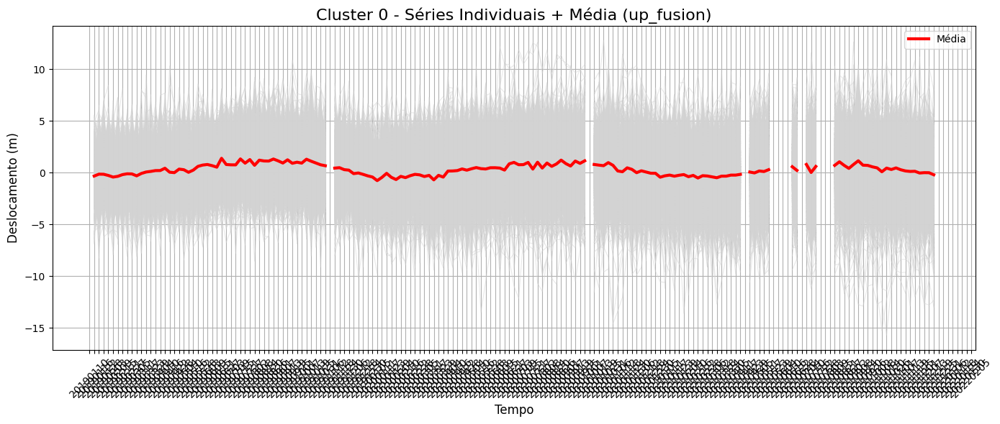

In [37]:
import matplotlib.pyplot as plt
import numpy as np

# Pegar de novo as séries
serie_temporal = up_fusion.values
tempo = up_fusion.columns  # Supondo que suas colunas são o tempo (datas ou épocas)

# Número de clusters (tirando -1)
clusters_validos = np.unique(gdf["cluster"])
clusters_validos = clusters_validos[clusters_validos != -1]

# Para cada cluster
for cluster_id in clusters_validos:
    # Seleciona as séries do cluster
    idx = gdf["cluster"] == cluster_id
    series_cluster = serie_temporal[idx.values]
    
    # Plot
    fig, ax = plt.subplots(figsize=(14, 6))
    
    # Plotar todas as séries individuais
    for serie in series_cluster:
        ax.plot(tempo, serie, color='lightgray', linewidth=0.8, alpha=0.5)

    # Plotar a média (em vermelho)
    media_cluster = np.nanmean(series_cluster, axis=0)
    ax.plot(tempo, media_cluster, color='red', linewidth=3, label='Média')

    # Estética
    ax.set_title(f"Cluster {cluster_id} - Séries Individuais + Média ({nome_componente})", fontsize=16)
    ax.set_xlabel("Tempo", fontsize=12)
    ax.set_ylabel("Deslocamento (m)", fontsize=12)
    ax.legend()
    ax.grid(True)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


In [31]:
df_asc

,pid,mp_type,latitude,longitude,easting,northing,height,height_wgs84,line,pixel,...,20230910,20230922,20231004,20231016,20231109,20231121,20231203,20231215,20231227,mean_up_fusion
821977,4eR7j4UrEJ,5072,38.191540,-7.500285,2792271.61,1855053.61,160.7,215.9,1014,6299,...,14.1,11.6,14.4,9.8,11.6,15.3,14.7,13.8,10.4,NaN
821979,4eR7j4VPKX,5438,38.191826,-7.500066,2792296.77,1855080.18,150.2,205.4,1016,6309,...,3.6,3.5,2.0,2.5,7.4,6.2,8.9,8.1,7.1,NaN
821980,4eR7j4VPKg,7007,38.191869,-7.499765,2792323.55,1855078.72,144.5,199.7,1016,6318,...,7.3,6.5,2.9,-0.5,-17.4,-19.7,5.4,-12.2,-13.3,NaN
821981,4eR7j4VgNi,7164,38.191990,-7.499813,2792322.13,1855092.77,143.1,198.3,1017,6318,...,-1.6,2.5,4.0,-7.0,-19.7,-20.1,-0.3,-9.1,-14.5,NaN
821983,4eR7j4VPLW,6379,38.192143,-7.497819,2792496.35,1855069.28,125.7,180.9,1016,6370,...,-15.7,-18.1,-22.6,-23.1,-21.0,-28.5,-30.3,-20.6,-23.3,-2.355388
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
866039,4eR7j4ibg9,0,38.197814,-7.501022,2792350.48,1855747.63,166.1,221.3,1064,6313,...,4.3,8.2,9.6,8.6,16.6,8.3,13.3,16.8,-2.1,1.902856
866040,4eR7j4isj5,0,38.197909,-7.501258,2792332.40,1855762.58,169.4,224.6,1065,6307,...,12.4,14.7,-1.4,5.9,10.9,5.8,10.7,12.5,13.4,0.927257
866041,4eR7j4isj6,0,38.197911,-7.501242,2792333.82,1855762.51,167.6,222.8,1065,6308,...,12.3,15.1,3.3,7.4,10.0,5.0,10.6,10.5,12.6,1.638654
866042,4eR7j4j9m7,0,38.198029,-7.501305,2792331.09,1855776.62,168.1,223.3,1066,6307,...,12.7,16.5,-5.2,9.2,8.6,9.9,13.0,11.9,12.9,0.905934


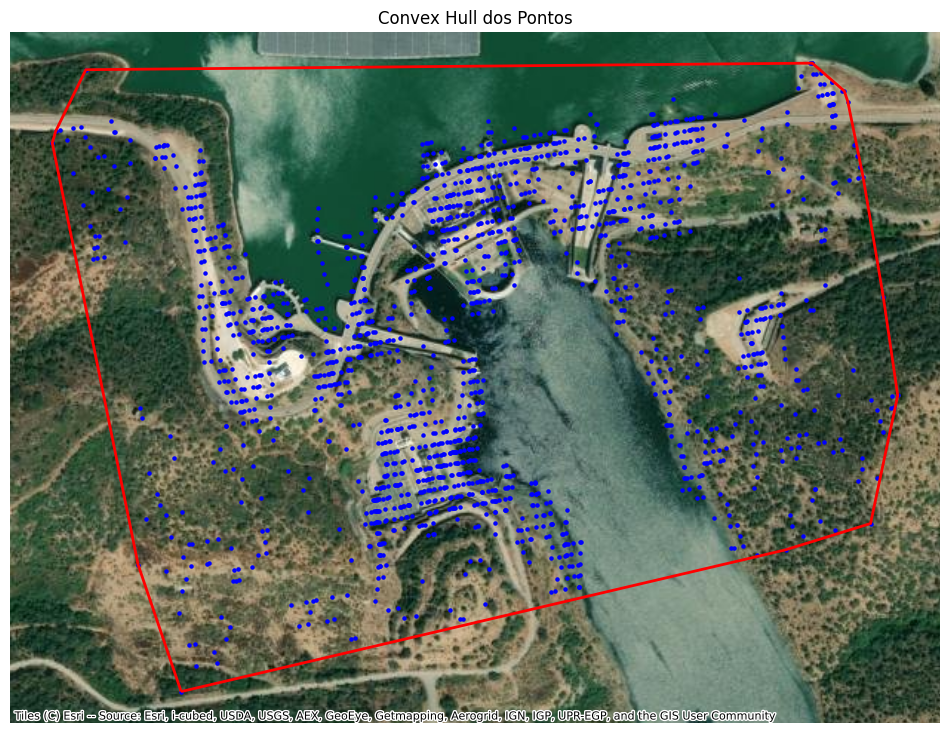

In [15]:
from shapely.geometry import MultiPoint

# Cria um multiponto a partir dos pontos
multi_point = MultiPoint(gdf_web.geometry.tolist())

# Cria o "convex hull" (fecho convexo)
hull_polygon = multi_point.convex_hull

# Cria GeoDataFrame para plotar
gdf_hull = gpd.GeoDataFrame(geometry=[hull_polygon], crs=gdf_web.crs)

# Plot
fig, ax = plt.subplots(figsize=(12, 10))
gdf_web.plot(ax=ax, color="blue", markersize=5)
gdf_hull.plot(ax=ax, facecolor="none", edgecolor="red", linewidth=2)
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)
ax.set_axis_off()
plt.title("Convex Hull dos Pontos")
plt.show()


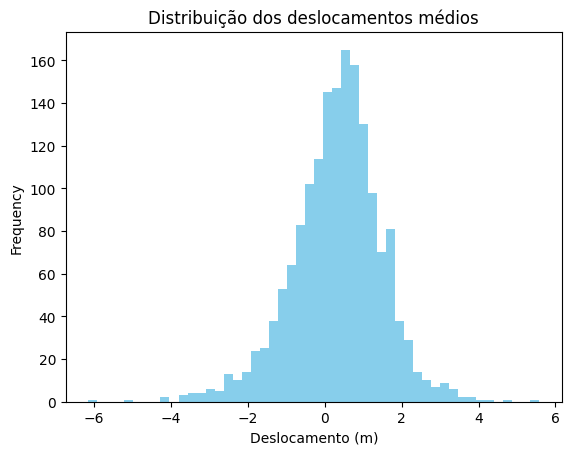

In [22]:
gdf_web['mean_up_fusion'].plot.hist(bins=50, color='skyblue')
plt.title("Distribuição dos deslocamentos médios")
plt.xlabel("Deslocamento (m)")
plt.show()


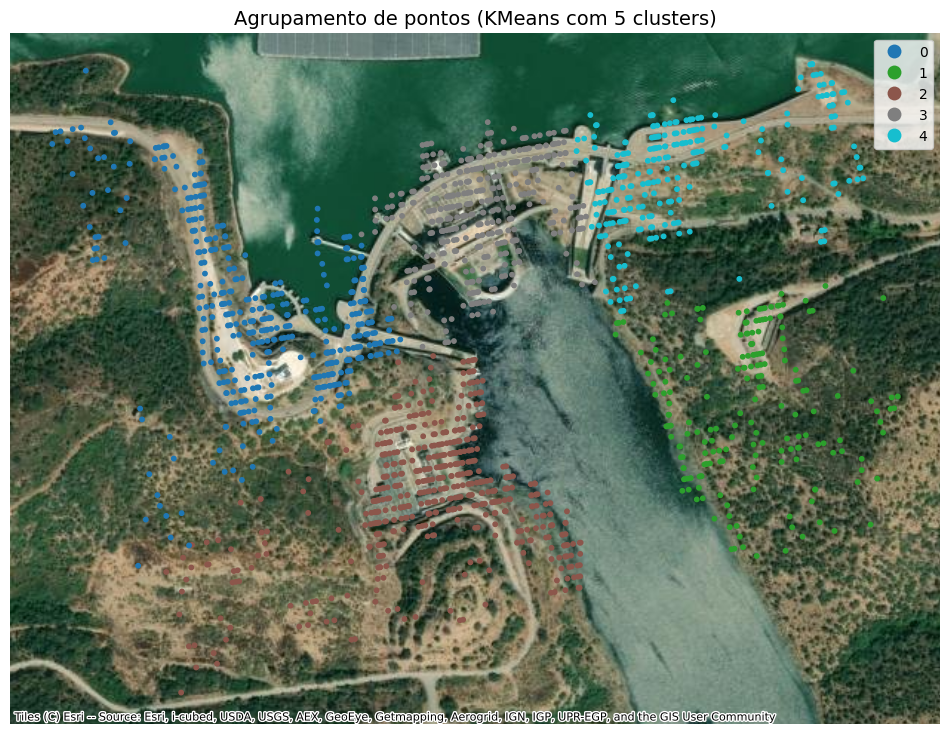

In [38]:
from sklearn.cluster import KMeans
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# Número de clusters (podes ajustar)
n_clusters = 5

# --- Criar GeoDataFrame ---
gdf = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
)
gdf_web = gdf.to_crs(epsg=3857)

# --- KMeans clustering com coordenadas projetadas ---
coords = np.vstack([gdf_web.geometry.x, gdf_web.geometry.y]).T
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(coords)
gdf_web["cluster"] = kmeans.labels_

# --- Plot ---
fig, ax = plt.subplots(figsize=(12, 10))
gdf_web.plot(ax=ax, column="cluster", categorical=True, legend=True, cmap="tab10", markersize=10)
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)
ax.set_axis_off()
plt.title(f"Agrupamento de pontos (KMeans com {n_clusters} clusters)", fontsize=14)
plt.show()


In [51]:
df_asc

,pid,mp_type,latitude,longitude,easting,northing,height,height_wgs84,line,pixel,...,20230910,20230922,20231004,20231016,20231109,20231121,20231203,20231215,20231227,mean_up_fusion
821977,4eR7j4UrEJ,5072,38.191540,-7.500285,2792271.61,1855053.61,160.7,215.9,1014,6299,...,14.1,11.6,14.4,9.8,11.6,15.3,14.7,13.8,10.4,NaN
821979,4eR7j4VPKX,5438,38.191826,-7.500066,2792296.77,1855080.18,150.2,205.4,1016,6309,...,3.6,3.5,2.0,2.5,7.4,6.2,8.9,8.1,7.1,NaN
821980,4eR7j4VPKg,7007,38.191869,-7.499765,2792323.55,1855078.72,144.5,199.7,1016,6318,...,7.3,6.5,2.9,-0.5,-17.4,-19.7,5.4,-12.2,-13.3,NaN
821981,4eR7j4VgNi,7164,38.191990,-7.499813,2792322.13,1855092.77,143.1,198.3,1017,6318,...,-1.6,2.5,4.0,-7.0,-19.7,-20.1,-0.3,-9.1,-14.5,NaN
821983,4eR7j4VPLW,6379,38.192143,-7.497819,2792496.35,1855069.28,125.7,180.9,1016,6370,...,-15.7,-18.1,-22.6,-23.1,-21.0,-28.5,-30.3,-20.6,-23.3,-2.355388
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
866039,4eR7j4ibg9,0,38.197814,-7.501022,2792350.48,1855747.63,166.1,221.3,1064,6313,...,4.3,8.2,9.6,8.6,16.6,8.3,13.3,16.8,-2.1,1.902856
866040,4eR7j4isj5,0,38.197909,-7.501258,2792332.40,1855762.58,169.4,224.6,1065,6307,...,12.4,14.7,-1.4,5.9,10.9,5.8,10.7,12.5,13.4,0.927257
866041,4eR7j4isj6,0,38.197911,-7.501242,2792333.82,1855762.51,167.6,222.8,1065,6308,...,12.3,15.1,3.3,7.4,10.0,5.0,10.6,10.5,12.6,1.638654
866042,4eR7j4j9m7,0,38.198029,-7.501305,2792331.09,1855776.62,168.1,223.3,1066,6307,...,12.7,16.5,-5.2,9.2,8.6,9.9,13.0,11.9,12.9,0.905934


C:\Users\tiago\AppData\Local\Temp\ipykernel_19844\2683778108.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', n_clusters)
C:\Users\tiago\AppData\Local\Temp\ipykernel_19844\2683778108.py:67: RuntimeWarning: Mean of empty slice
  media_cluster = np.nanmean(series_cluster, axis=0)
C:\Users\tiago\AppData\Local\Temp\ipykernel_19844\2683778108.py:84: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


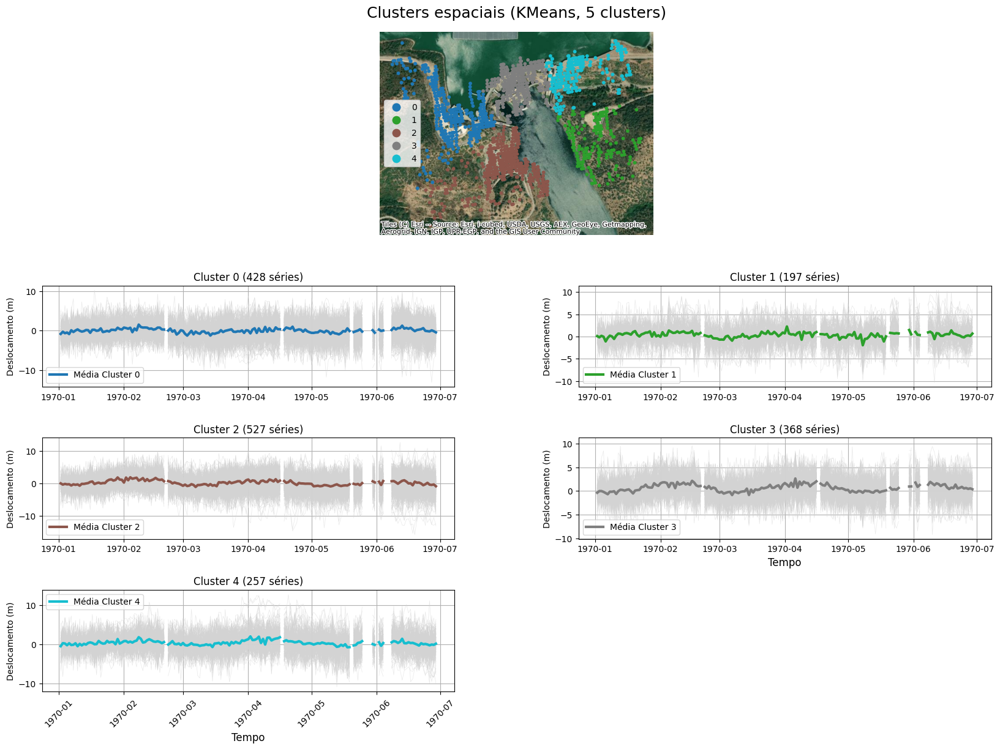

In [50]:
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from sklearn.cluster import KMeans
from matplotlib import cm
import matplotlib.dates as mdates

# Número de clusters
n_clusters = 5

# --- Criar GeoDataFrame ---
gdf = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
)
gdf_web = gdf.to_crs(epsg=3857)

# --- KMeans clustering ---
coords = np.vstack([gdf_web.geometry.x, gdf_web.geometry.y]).T
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(coords)
gdf_web["cluster"] = kmeans.labels_

# --- Séries temporais ---
serie_temporal = up_fusion.values
tempo = up_fusion.columns

# --- Cores para médias ---
cmap = cm.get_cmap('tab10', n_clusters)
cores_clusters = [cmap(i) for i in range(n_clusters)]

# --- Layout com matplotlib gridspec ---
import matplotlib.gridspec as gridspec

# Número de linhas necessárias para os subplots
ncols = 2
nrows = int(np.ceil(n_clusters / ncols))  # arredonda para cima

fig = plt.figure(figsize=(20, 5 + 3 * nrows))
gs = gridspec.GridSpec(nrows + 1, ncols, height_ratios=[2] + [1]*nrows, hspace=0.4, wspace=0.3)

# --- Mapa na primeira linha (ocupando as 2 colunas) ---
ax_mapa = fig.add_subplot(gs[0, :])
gdf_web.plot(ax=ax_mapa, column="cluster", categorical=True, legend=True, cmap="tab10", markersize=10)
ctx.add_basemap(ax_mapa, source=ctx.providers.Esri.WorldImagery)
ax_mapa.set_axis_off()
ax_mapa.set_title(f"Clusters espaciais (KMeans, {n_clusters} clusters)", fontsize=18)

# --- Plots para cada cluster ---
clusters_validos = np.unique(gdf_web["cluster"])

for i, cluster_id in enumerate(clusters_validos):
    row = (i // ncols) + 1  # +1 por causa do mapa
    col = i % ncols
    ax = fig.add_subplot(gs[row, col])
    
    # Pegar séries do cluster
    idx = gdf_web["cluster"] == cluster_id
    series_cluster = serie_temporal[idx.values]
    
    # Plotar séries individuais (cinza)
    for serie in series_cluster:
        ax.plot(tempo, serie, color='lightgray', linewidth=0.5, alpha=0.5)
    
    # Plotar linha média
    media_cluster = np.nanmean(series_cluster, axis=0)
    ax.plot(tempo, media_cluster, color=cores_clusters[cluster_id], linewidth=3, label=f"Média Cluster {cluster_id}")
    
    ax.set_title(f"Cluster {cluster_id} ({series_cluster.shape[0]} séries)", fontsize=12)
    ax.grid(True)
    ax.legend()
    ax.set_ylabel("Deslocamento (m)")

    # Melhorar eixo de datas
    ax.xaxis.set_major_locator(mdates.AutoDateLocator(minticks=4, maxticks=8))
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))

# Eixo X apenas na última linha
for ax in fig.get_axes()[-ncols:]:
    ax.set_xlabel("Tempo", fontsize=12)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



C:\Users\tiago\AppData\Local\Temp\ipykernel_19844\2426651995.py:30: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap('tab10', n_clusters)
C:\Users\tiago\AppData\Local\Temp\ipykernel_19844\2426651995.py:64: RuntimeWarning: Mean of empty slice
  media_cluster = np.nanmean(series_cluster, axis=0)
C:\Users\tiago\AppData\Local\Temp\ipykernel_19844\2426651995.py:82: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


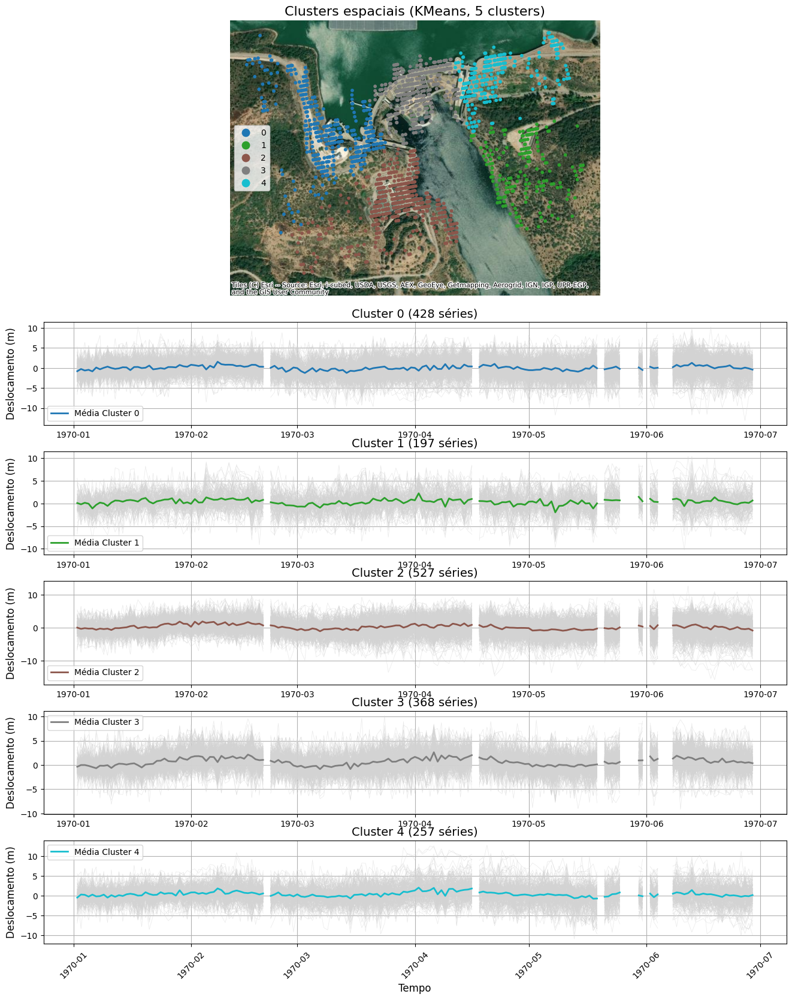

In [57]:
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
from sklearn.cluster import KMeans
from matplotlib import cm
import matplotlib.dates as mdates

# Número de clusters
n_clusters = 5

# --- Criar GeoDataFrame ---
gdf = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
)
gdf_web = gdf.to_crs(epsg=3857)

# --- KMeans clustering ---
coords = np.vstack([gdf_web.geometry.x, gdf_web.geometry.y]).T
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(coords)
gdf_web["cluster"] = kmeans.labels_

# --- Séries temporais ---
serie_temporal = up_fusion.values
tempo = up_fusion.columns

# --- Cores para médias ---
cmap = cm.get_cmap('tab10', n_clusters)
cores_clusters = [cmap(i) for i in range(n_clusters)]

# --- Layout com matplotlib gridspec ---
import matplotlib.gridspec as gridspec

# Definir o número de colunas e linhas para o layout
ncols = 1  # Mapa na primeira linha, gráficos nas linhas seguintes
nrows = n_clusters + 1  # Uma linha para o mapa, e n_clusters para os gráficos
fig = plt.figure(figsize=(16, 5 + 2.5 * nrows))  # Ajusta a largura para o mapa maior
gs = gridspec.GridSpec(nrows, ncols, height_ratios=[2] + [0.75]*n_clusters, wspace=0.3)

# --- Mapa na primeira linha ---
ax_mapa = fig.add_subplot(gs[0, 0])  # O mapa ocupa a primeira linha
gdf_web.plot(ax=ax_mapa, column="cluster", categorical=True, legend=True, cmap="tab10", markersize=10)
ctx.add_basemap(ax_mapa, source=ctx.providers.Esri.WorldImagery)
ax_mapa.set_axis_off()
ax_mapa.set_title(f"Clusters espaciais (KMeans, {n_clusters} clusters)", fontsize=16)

# --- Plots para cada cluster nas linhas seguintes ---
clusters_validos = np.unique(gdf_web["cluster"])

for i, cluster_id in enumerate(clusters_validos):
    ax = fig.add_subplot(gs[i + 1, 0])  # Os gráficos ocupam as linhas seguintes
    
    # Pegar séries do cluster
    idx = gdf_web["cluster"] == cluster_id
    series_cluster = serie_temporal[idx.values]
    
    # Plotar séries individuais (cinza)
    for serie in series_cluster:
        ax.plot(tempo, serie, color='lightgray', linewidth=0.5, alpha=0.5)
    
    # Plotar linha média
    media_cluster = np.nanmean(series_cluster, axis=0)
    ax.plot(tempo, media_cluster, color=cores_clusters[cluster_id], linewidth=2, label=f"Média Cluster {cluster_id}")
    
    ax.set_title(f"Cluster {cluster_id} ({series_cluster.shape[0]} séries)", fontsize=14)
    ax.grid(True)
    ax.legend()
    ax.set_ylabel("Deslocamento (m)", fontsize=12)

    # Ajustar eixo de datas
    ax.xaxis.set_major_locator(mdates.AutoDateLocator(minticks=4, maxticks=8))
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))

# Eixo X apenas na última linha
for ax in fig.get_axes()[-ncols:]:
    ax.set_xlabel("Tempo", fontsize=12)

# Ajustar rotação das datas
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


C:\Users\tiago\AppData\Local\Temp\ipykernel_8428\3006108186.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asc[f"mean_{nome_componente}"] = componente.mean(axis=1)


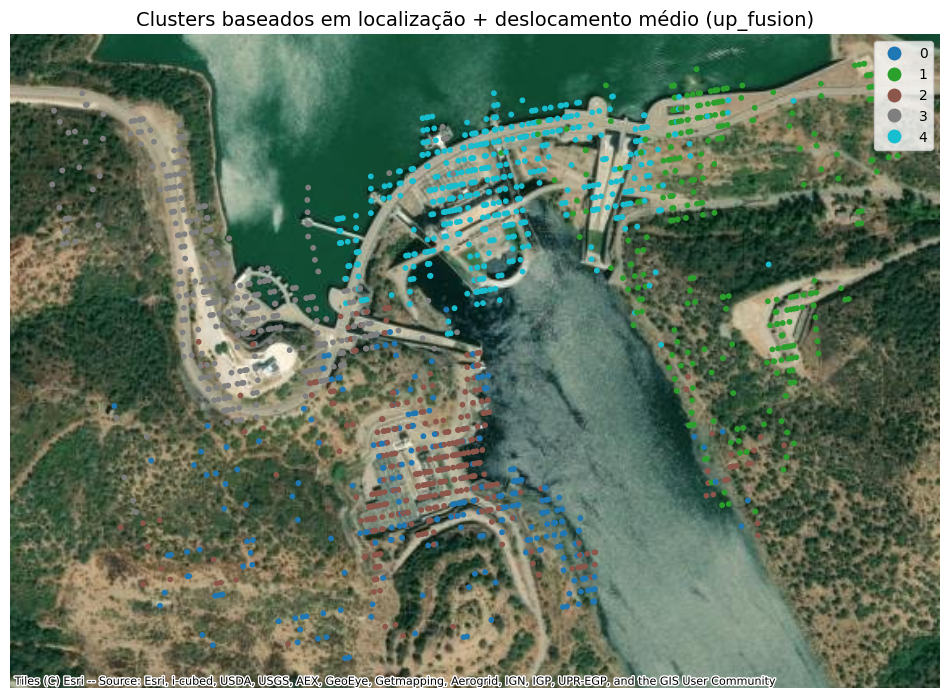

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib.cm import ScalarMappable
import contextily as ctx
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import numpy as np

# === CONFIGURAÇÃO ===
componente = up_fusion
nome_componente = "up_fusion"

# Adiciona média da série temporal ao DataFrame original
df_asc[f"mean_{nome_componente}"] = componente.mean(axis=1)

# === CRIAÇÃO DO GDF ===
gdf = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# === Remover pontos com NaN na média
gdf = gdf.dropna(subset=[f"mean_{nome_componente}"])

# === CLUSTERING ===
X = np.vstack([
    gdf.geometry.x,
    gdf.geometry.y,
    gdf[f"mean_{nome_componente}"]
]).T

X_scaled = StandardScaler().fit_transform(X)

k = 5  # número de clusters
kmeans = KMeans(n_clusters=k, random_state=0, n_init="auto").fit(X_scaled)
gdf["cluster"] = kmeans.labels_

# === PLOT ===
fig, ax = plt.subplots(figsize=(12, 10))
gdf.plot(
    ax=ax,
    column="cluster",
    categorical=True,
    cmap="tab10",
    markersize=10,
    legend=True
)
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)
ax.set_axis_off()
plt.title(f"Clusters baseados em localização + deslocamento médio ({nome_componente})", fontsize=14)
plt.show()



C:\Users\tiago\AppData\Local\Temp\ipykernel_8428\3285729379.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asc[f"mean_{nome_componente}"] = componente.mean(axis=1)


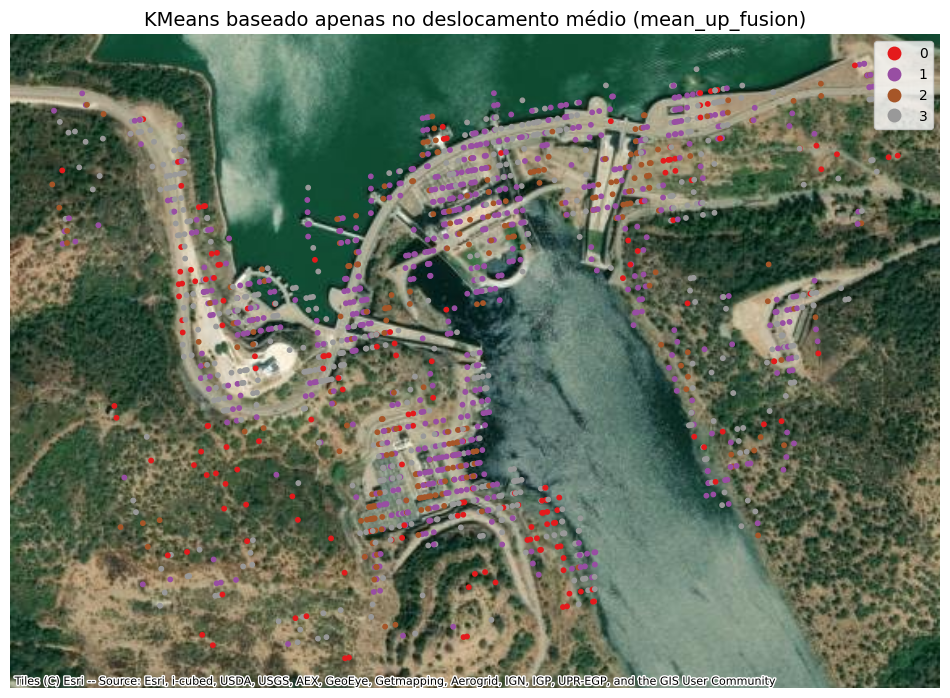

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from matplotlib.cm import ScalarMappable
from sklearn.cluster import KMeans
import contextily as ctx
import numpy as np

# === CONFIGURAÇÃO ===
componente = up_fusion
nome_componente = "up_fusion"

# === MÉDIA DO DESLOCAMENTO ===
df_asc[f"mean_{nome_componente}"] = componente.mean(axis=1)

# === CRIAÇÃO DO GeoDataFrame ===
gdf = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
)
gdf_web = gdf.to_crs(epsg=3857)

# === PREPARAR DADOS PARA KMEANS ===
coluna_valor = f"mean_{nome_componente}"
gdf_kmeans = gdf_web.dropna(subset=[coluna_valor]).copy()

X = gdf_kmeans[[coluna_valor]].values  # Apenas deslocamento

# === APLICAR KMEANS ===
n_clusters = 4  # podes ajustar conforme quiseres
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
gdf_kmeans["cluster"] = kmeans.fit_predict(X)

# === VISUALIZAÇÃO ===
fig, ax = plt.subplots(figsize=(12, 10))

gdf_kmeans.plot(
    ax=ax,
    column="cluster",
    categorical=True,
    cmap="Set1",
    markersize=10,
    legend=True
)

ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)
ax.set_axis_off()
ax.set_title(f"KMeans baseado apenas no deslocamento médio ({coluna_valor})", fontsize=14)

plt.show()




In [ ]:
df_nivel = pd.read_excel("data/nivel.xlsx")
df_nivel

,data,nivel
0,2020-12-23 09:00:00,145.05
1,2020-12-22 09:00:00,144.95
2,2020-12-21 09:00:00,144.90
3,2020-12-18 09:00:00,144.53
4,2020-12-17 09:00:00,144.55
...,...,...
1185,2016-01-11 09:00:00,147.67
1186,2016-01-08 09:00:00,147.51
1187,2016-01-07 09:00:00,147.50
1188,2016-01-06 09:00:00,147.42


C:\Users\tiago\AppData\Local\Temp\ipykernel_8428\3055750895.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)


Ponto com maior correlação: 853429, Correlação = -0.71


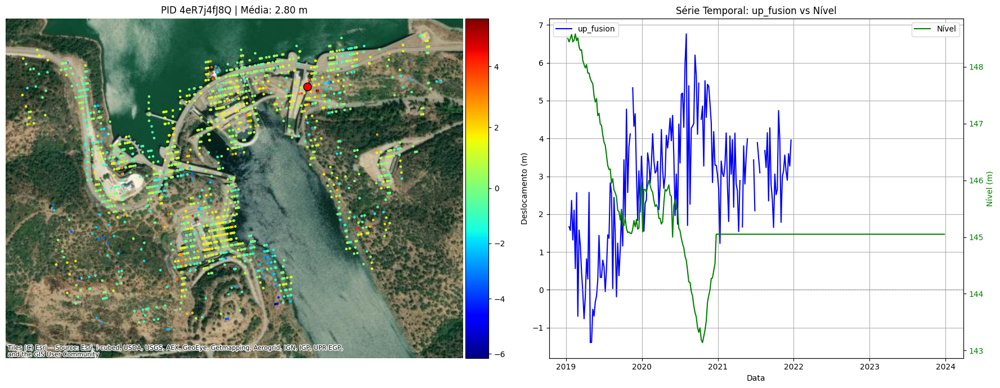

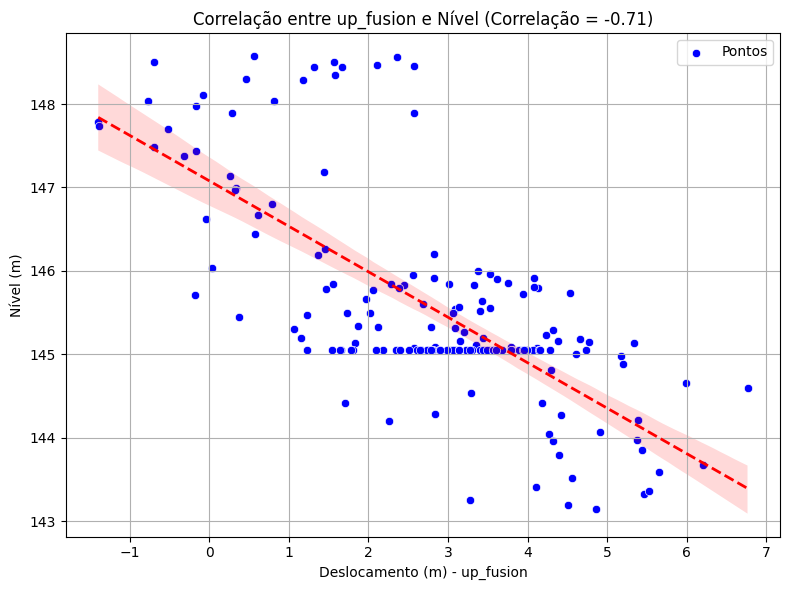

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns
import numpy as np

# ---------- CÁLCULO DA MÉDIA VERTICAL ----------
df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)

# Colunas temporais e datas
colunas_temporais = [col for col in up_fusion.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# ---------- PREPARAR GEO ----------
gdf_all = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# Escala de cores
norm = colors.TwoSlopeNorm(
    vmin=df_asc["mean_up_fusion"].min(),
    vcenter=0,
    vmax=df_asc["mean_up_fusion"].max()
)

# Limites do mapa
xmin, ymin, xmax, ymax = gdf_all.total_bounds

# ---------- CALCULAR A CORRELAÇÃO PARA TODOS OS PONTOS ----------
correlations = {}

# Prepara o df_nivel
df_nivel['data'] = pd.to_datetime(df_nivel['data'])
df_nivel.set_index('data', inplace=True)

for idx in up_fusion.index:
    serie_up = up_fusion.loc[idx, colunas_temporais].astype(float)
    nivel_data = df_nivel.reindex(datas, method='nearest')
    nivel_data_values = nivel_data['nivel'].values

    # Remover NaN
    valid_data = ~np.isnan(serie_up) & ~np.isnan(nivel_data_values)
    if valid_data.sum() > 1:
        corr = np.corrcoef(serie_up[valid_data], nivel_data_values[valid_data])[0,1]
        correlations[idx] = corr

# Converter dicionário em Series
correlations = pd.Series(correlations)

# Pegar o ponto com maior correlação (em módulo)
idx_max_corr = correlations.abs().idxmax()
corr_value = correlations[idx_max_corr]

print(f"Ponto com maior correlação: {idx_max_corr}, Correlação = {corr_value:.2f}")

# ---------- PREPARAR OS DADOS DESSE PONTO ----------
row = df_asc.loc[idx_max_corr]
gdf_row = gpd.GeoDataFrame(
    pd.DataFrame([row]),
    geometry=gpd.points_from_xy([row.easting], [row.northing]),
    crs="EPSG:3035"
).to_crs(epsg=3857)

serie_up_fusion = up_fusion.loc[idx_max_corr, colunas_temporais].astype(float)
nivel_data = df_nivel.reindex(datas, method='nearest')
nivel_data_values = nivel_data['nivel'].values

# Limpar NaNs
valid_data = ~np.isnan(serie_up_fusion) & ~np.isnan(nivel_data_values)
serie_up_fusion_clean = serie_up_fusion[valid_data]
nivel_data_values_clean = nivel_data_values[valid_data]

# ---------- PLOTAR MAPA + SÉRIE TEMPORAL ----------
fig, axs = plt.subplots(1, 2, figsize=(18, 7), gridspec_kw={'width_ratios': [1.2, 1]})
fig.subplots_adjust(hspace=0.5, wspace=0.3)

# Mapa
ax_map = axs[0]
divider = make_axes_locatable(ax_map)
cax = divider.append_axes("right", size="5%", pad=0.05)

gdf_all.plot(
    ax=ax_map,
    column="mean_up_fusion",
    cmap="jet",
    markersize=5,
    norm=norm,
    legend=True,
    cax=cax
)
gdf_row.plot(
    ax=ax_map,
    color="red",
    edgecolor="black",
    markersize=100
)
ctx.add_basemap(ax_map, source=ctx.providers.Esri.WorldImagery)

ax_map.set_xlim(xmin, xmax)
ax_map.set_ylim(ymin, ymax)
ax_map.set_title(f"PID {row['pid']} | Média: {row['mean_up_fusion']:.2f} m")
ax_map.set_axis_off()

# Séries temporais
ax_series = axs[1]
ax_series.plot(datas, serie_up_fusion, color="blue", label="up_fusion")
ax_series.axhline(0, color='gray', linestyle='--', linewidth=0.7)
ax_series.set_title("Série Temporal: up_fusion vs Nível")
ax_series.set_ylabel("Deslocamento (m)")
ax_series.set_xlabel("Data")
ax_series.grid(True)

if len(nivel_data) > 0:
    ax2 = ax_series.twinx()
    ax2.plot(datas, nivel_data['nivel'], color="green", label="Nível")
    ax2.set_ylabel("Nível (m)", color="green")
    ax2.tick_params(axis='y', labelcolor="green")
    ax_series.legend(loc='upper left')
    ax2.legend(loc='upper right')
else:
    print("Nenhum dado de nível disponível.")

plt.tight_layout()
plt.show()

# ---------- PLOTAR DISPERSÃO ----------
plt.figure(figsize=(8, 6))
sns.scatterplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, color="blue", label="Pontos")

# Linha de regressão
sns.regplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, scatter=False, color="red", line_kws={"lw": 2, "ls": "--"})

plt.title(f'Correlação entre up_fusion e Nível (Correlação = {corr_value:.2f})')
plt.xlabel('Deslocamento (m) - up_fusion')
plt.ylabel('Nível (m)')
plt.grid(True)
plt.tight_layout()
plt.show()


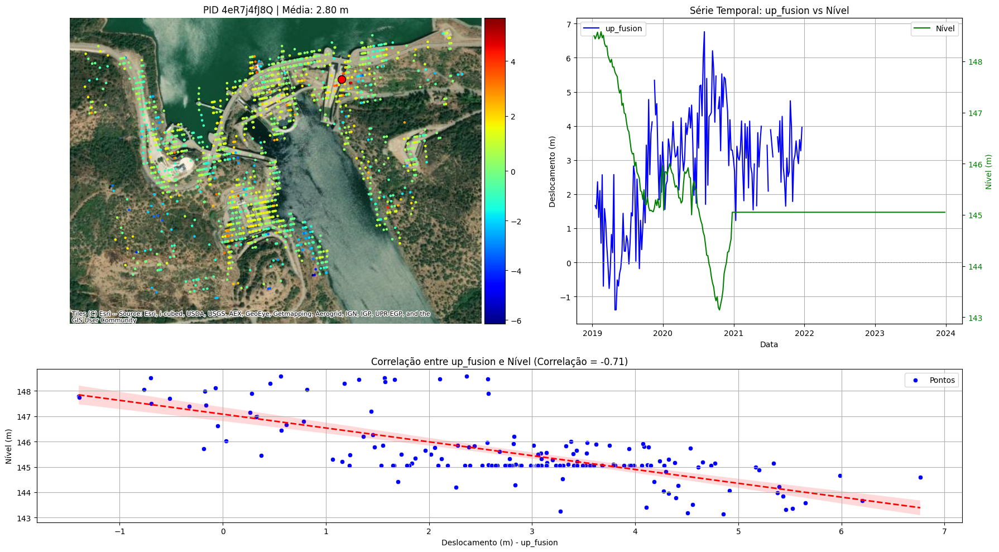

In [ ]:
import matplotlib.gridspec as gridspec

# ------- Layout melhorado para mapa + série temporal + dispersão -------
fig = plt.figure(figsize=(18, 10))  # Tamanho maior
gs = gridspec.GridSpec(2, 2, height_ratios=[2, 1], width_ratios=[1.3, 1])

# Mapa
ax_map = fig.add_subplot(gs[0, 0])
divider = make_axes_locatable(ax_map)
cax = divider.append_axes("right", size="5%", pad=0.05)

gdf_all.plot(
    ax=ax_map,
    column="mean_up_fusion",
    cmap="jet",
    markersize=5,
    norm=norm,
    legend=True,
    cax=cax
)
gdf_row.plot(
    ax=ax_map,
    color="red",
    edgecolor="black",
    markersize=100
)
ctx.add_basemap(ax_map, source=ctx.providers.Esri.WorldImagery)

ax_map.set_xlim(xmin, xmax)
ax_map.set_ylim(ymin, ymax)
ax_map.set_title(f"PID {row['pid']} | Média: {row['mean_up_fusion']:.2f} m")
ax_map.set_axis_off()

# Série Temporal
ax_series = fig.add_subplot(gs[0, 1])
ax_series.plot(datas, serie_up_fusion, color="blue", label="up_fusion")
ax_series.axhline(0, color='gray', linestyle='--', linewidth=0.7)
ax_series.set_title("Série Temporal: up_fusion vs Nível")
ax_series.set_ylabel("Deslocamento (m)")
ax_series.set_xlabel("Data")
ax_series.grid(True)

if len(nivel_data) > 0:
    ax2 = ax_series.twinx()
    ax2.plot(datas, nivel_data['nivel'], color="green", label="Nível")
    ax2.set_ylabel("Nível (m)", color="green")
    ax2.tick_params(axis='y', labelcolor="green")
    ax_series.legend(loc='upper left')
    ax2.legend(loc='upper right')
else:
    print("Nenhum dado de nível disponível.")

# Dispersão Correlação
ax_corr = fig.add_subplot(gs[1, :])
sns.scatterplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, color="blue", label="Pontos", ax=ax_corr)
sns.regplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, scatter=False, color="red", line_kws={"lw": 2, "ls": "--"}, ax=ax_corr)

ax_corr.set_title(f'Correlação entre up_fusion e Nível (Correlação = {corr_value:.2f})')
ax_corr.set_xlabel('Deslocamento (m) - up_fusion')
ax_corr.set_ylabel('Nível (m)')
ax_corr.grid(True)

plt.tight_layout()
plt.show()


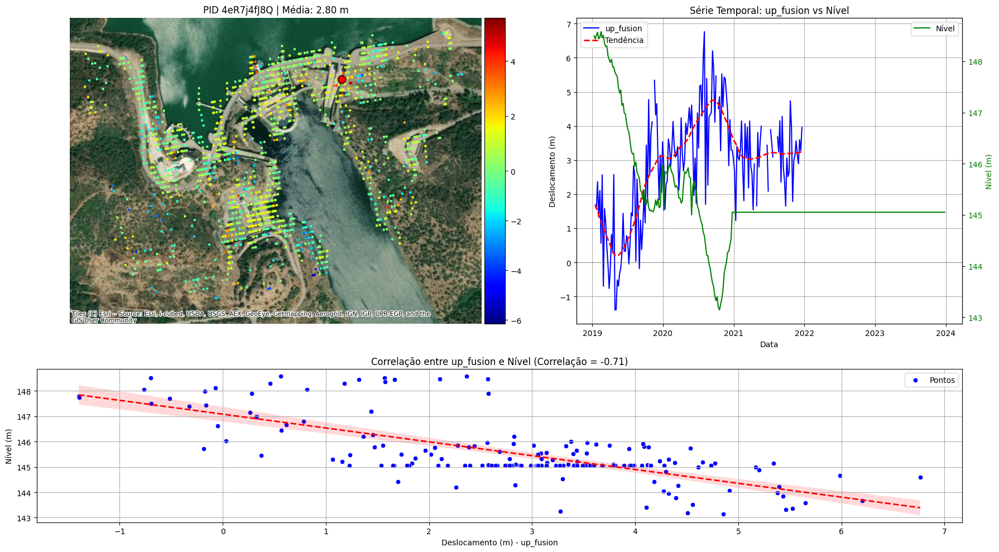

In [ ]:
import matplotlib.gridspec as gridspec
import statsmodels.api as sm  # <-- importar para a tendência

# ------- Layout melhorado para mapa + série temporal + dispersão -------
fig = plt.figure(figsize=(18, 10))  # Tamanho maior
gs = gridspec.GridSpec(2, 2, height_ratios=[2, 1], width_ratios=[1.3, 1])

# Mapa
ax_map = fig.add_subplot(gs[0, 0])
divider = make_axes_locatable(ax_map)
cax = divider.append_axes("right", size="5%", pad=0.05)

gdf_all.plot(
    ax=ax_map,
    column="mean_up_fusion",
    cmap="jet",
    markersize=5,
    norm=norm,
    legend=True,
    cax=cax
)
gdf_row.plot(
    ax=ax_map,
    color="red",
    edgecolor="black",
    markersize=100
)
ctx.add_basemap(ax_map, source=ctx.providers.Esri.WorldImagery)

ax_map.set_xlim(xmin, xmax)
ax_map.set_ylim(ymin, ymax)
ax_map.set_title(f"PID {row['pid']} | Média: {row['mean_up_fusion']:.2f} m")
ax_map.set_axis_off()

# Série Temporal
ax_series = fig.add_subplot(gs[0, 1])
ax_series.plot(datas, serie_up_fusion, color="blue", label="up_fusion")
ax_series.axhline(0, color='gray', linestyle='--', linewidth=0.7)

# --- Adicionar curva de tendência (LOWESS) ---
lowess = sm.nonparametric.lowess
smoothed = lowess(serie_up_fusion.values, datas.values.astype(float), frac=0.2)  # datas precisam estar em float para LOWESS
ax_series.plot(pd.to_datetime(smoothed[:, 0]), smoothed[:, 1], color="red", linestyle="--", linewidth=2, label="Tendência")
# ------------------------------------------------

ax_series.set_title("Série Temporal: up_fusion vs Nível")
ax_series.set_ylabel("Deslocamento (m)")
ax_series.set_xlabel("Data")
ax_series.grid(True)

if len(nivel_data) > 0:
    ax2 = ax_series.twinx()
    ax2.plot(datas, nivel_data['nivel'], color="green", label="Nível")
    ax2.set_ylabel("Nível (m)", color="green")
    ax2.tick_params(axis='y', labelcolor="green")
    ax_series.legend(loc='upper left')
    ax2.legend(loc='upper right')
else:
    print("Nenhum dado de nível disponível.")

# Dispersão Correlação
ax_corr = fig.add_subplot(gs[1, :])
sns.scatterplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, color="blue", label="Pontos", ax=ax_corr)
sns.regplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, scatter=False, color="red", line_kws={"lw": 2, "ls": "--"}, ax=ax_corr)

ax_corr.set_title(f'Correlação entre up_fusion e Nível (Correlação = {corr_value:.2f})')
ax_corr.set_xlabel('Deslocamento (m) - up_fusion')
ax_corr.set_ylabel('Nível (m)')
ax_corr.grid(True)

plt.tight_layout()
plt.show()


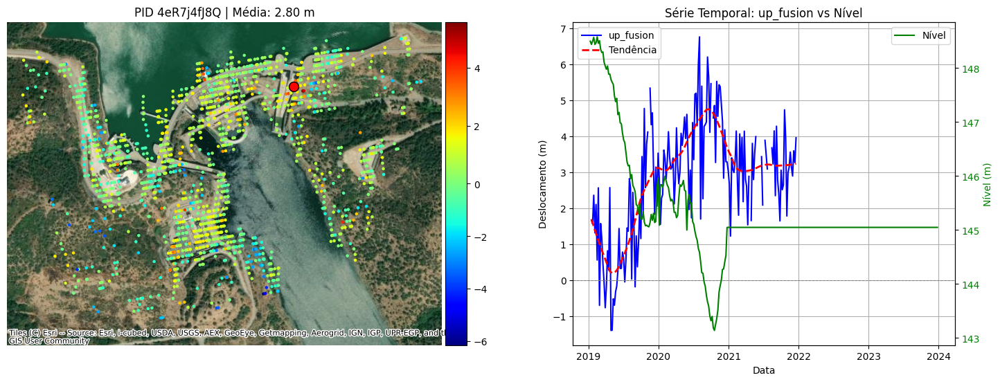

In [ ]:
import matplotlib.gridspec as gridspec

# ------- Layout melhorado para mapa + série temporal + dispersão -------
fig = plt.figure(figsize=(18, 10))  # Tamanho maior
gs = gridspec.GridSpec(2, 2, height_ratios=[2, 1], width_ratios=[1.3, 1])

# Mapa
ax_map = fig.add_subplot(gs[0, 0])
divider = make_axes_locatable(ax_map)
cax = divider.append_axes("right", size="5%", pad=0.05)

gdf_all.plot(
    ax=ax_map,
    column="mean_up_fusion",
    cmap="jet",
    markersize=5,
    norm=norm,
    legend=True,
    cax=cax
)
gdf_row.plot(
    ax=ax_map,
    color="red",
    edgecolor="black",
    markersize=100
)
ctx.add_basemap(ax_map, source=ctx.providers.Esri.WorldImagery)

ax_map.set_xlim(xmin, xmax)
ax_map.set_ylim(ymin, ymax)
ax_map.set_title(f"PID {row['pid']} | Média: {row['mean_up_fusion']:.2f} m")
ax_map.set_axis_off()

import statsmodels.api as sm

# [...] (resto igual até ao ax_series)

# Série Temporal
ax_series = fig.add_subplot(gs[0, 1])
ax_series.plot(datas, serie_up_fusion, color="blue", label="up_fusion")
ax_series.axhline(0, color='gray', linestyle='--', linewidth=0.7)

# --- Adicionar curva de tendência (LOWESS) ---
lowess = sm.nonparametric.lowess
smoothed = lowess(serie_up_fusion.values, datas.values, frac=0.2)  # frac controla o quanto suaviza (0.2 = suave)

ax_series.plot(pd.to_datetime(smoothed[:, 0]), smoothed[:, 1], color="red", linestyle="--", linewidth=2, label="Tendência")

# --- Fim da tendência ---

ax_series.set_title("Série Temporal: up_fusion vs Nível")
ax_series.set_ylabel("Deslocamento (m)")
ax_series.set_xlabel("Data")
ax_series.grid(True)

if len(nivel_data) > 0:
    ax2 = ax_series.twinx()
    ax2.plot(datas, nivel_data['nivel'], color="green", label="Nível")
    ax2.set_ylabel("Nível (m)", color="green")
    ax2.tick_params(axis='y', labelcolor="green")
    ax_series.legend(loc='upper left')
    ax2.legend(loc='upper right')
else:
    print("Nenhum dado de nível disponível.")


C:\Users\tiago\AppData\Local\Temp\ipykernel_8428\1632572044.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)


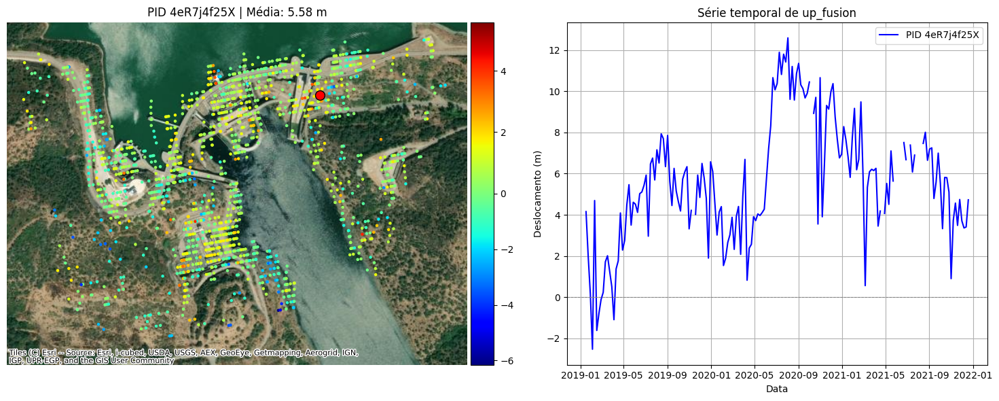

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable

# ---------- CÁLCULO DA MÉDIA VERTICAL ----------
df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)

# Seleciona o ponto com maior deslocamento vertical médio (exemplo: o primeiro ponto da lista top10)
top1 = df_asc.nlargest(1, "mean_up_fusion").copy()
top1_gdf = gpd.GeoDataFrame(
    top1,
    geometry=gpd.points_from_xy(top1.easting, top1.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# Colunas temporais e datas
colunas_temporais = [col for col in up_fusion.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# ---------- ESCALA DE CORES CONSISTENTE ----------
norm = colors.TwoSlopeNorm(
    vmin=df_asc["mean_up_fusion"].min(),
    vcenter=0,
    vmax=df_asc["mean_up_fusion"].max()
)

# ---------- Criar um GeoDataFrame para todos os pontos ----------
gdf_all = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# Encontrar os limites máximos para o mapa
xmin, ymin, xmax, ymax = gdf_all.total_bounds

# ---------- FIGURA COM SUBPLOTS ----------

# Ajuste o tamanho da figura
fig, axs = plt.subplots(1, 2, figsize=(15, 6), gridspec_kw={'width_ratios': [1.2, 1]})

# Ajuste o espaçamento entre os subgráficos
fig.subplots_adjust(hspace=0.5, wspace=0.3)

# Pegando o primeiro ponto de top1 para visualização
idx, row = top1.iloc[0].name, top1.iloc[0]

gdf_row = top1_gdf.loc[[idx]]  # GeoDataFrame de um ponto
ax_map = axs[0]
ax_series = axs[1]

# --- Mapa ---
divider = make_axes_locatable(ax_map)
cax = divider.append_axes("right", size="5%", pad=0.05)

gdf_all.plot(
    ax=ax_map,
    column="mean_up_fusion",
    cmap="jet",
    markersize=5,
    norm=norm,
    legend=True,
    cax=cax
)
gdf_row.plot(
    ax=ax_map,
    color="red",
    edgecolor="black",
    markersize=100
)
ctx.add_basemap(ax_map, source=ctx.providers.Esri.WorldImagery)

# Definindo o limite do mapa para mostrar todos os pontos
ax_map.set_xlim(xmin, xmax)
ax_map.set_ylim(ymin, ymax)

ax_map.set_title(f"PID {row['pid']} | Média: {row['mean_up_fusion']:.2f} m")
ax_map.set_axis_off()

# --- Série temporal ---
serie = up_fusion.loc[idx, colunas_temporais].astype(float)
ax_series.plot(datas, serie, color="blue", label=f"PID {row['pid']}")
ax_series.axhline(0, color='gray', linestyle='--', linewidth=0.7)
ax_series.set_title("Série temporal de up_fusion")
ax_series.set_ylabel("Deslocamento (m)")
ax_series.set_xlabel("Data")
ax_series.grid(True)
ax_series.legend()

plt.tight_layout()
plt.show()


C:\Users\tiago\AppData\Local\Temp\ipykernel_26744\3573745686.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)


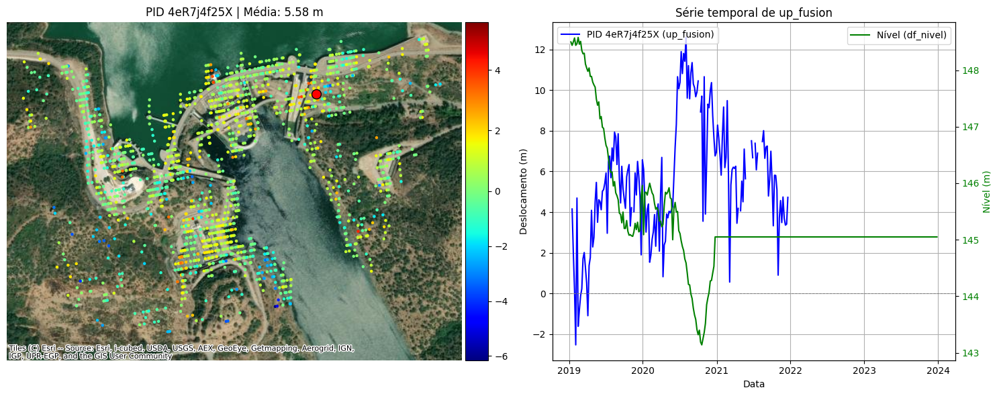

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable

# ---------- CÁLCULO DA MÉDIA VERTICAL ----------
df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)

# Seleciona o ponto com maior deslocamento vertical médio (exemplo: o primeiro ponto da lista top10)
top1 = df_asc.nlargest(1, "mean_up_fusion").copy()
top1_gdf = gpd.GeoDataFrame(
    top1,
    geometry=gpd.points_from_xy(top1.easting, top1.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# Colunas temporais e datas
colunas_temporais = [col for col in up_fusion.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# ---------- ESCALA DE CORES CONSISTENTE ----------
norm = colors.TwoSlopeNorm(
    vmin=df_asc["mean_up_fusion"].min(),
    vcenter=0,
    vmax=df_asc["mean_up_fusion"].max()
)

# ---------- Criar um GeoDataFrame para todos os pontos ----------
gdf_all = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# Encontrar os limites máximos para o mapa
xmin, ymin, xmax, ymax = gdf_all.total_bounds

# ---------- FIGURA COM SUBPLOTS ----------

# Ajuste o tamanho da figura
fig, axs = plt.subplots(1, 2, figsize=(15, 6), gridspec_kw={'width_ratios': [1.2, 1]})

# Ajuste o espaçamento entre os subgráficos
fig.subplots_adjust(hspace=0.5, wspace=0.3)

# Pegando o primeiro ponto de top1 para visualização
idx, row = top1.iloc[0].name, top1.iloc[0]

gdf_row = top1_gdf.loc[[idx]]  # GeoDataFrame de um ponto
ax_map = axs[0]
ax_series = axs[1]

# --- Mapa ---
divider = make_axes_locatable(ax_map)
cax = divider.append_axes("right", size="5%", pad=0.05)

gdf_all.plot(
    ax=ax_map,
    column="mean_up_fusion",
    cmap="jet",
    markersize=5,
    norm=norm,
    legend=True,
    cax=cax
)
gdf_row.plot(
    ax=ax_map,
    color="red",
    edgecolor="black",
    markersize=100
)
ctx.add_basemap(ax_map, source=ctx.providers.Esri.WorldImagery)

# Definindo o limite do mapa para mostrar todos os pontos
ax_map.set_xlim(xmin, xmax)
ax_map.set_ylim(ymin, ymax)

ax_map.set_title(f"PID {row['pid']} | Média: {row['mean_up_fusion']:.2f} m")
ax_map.set_axis_off()

# --- Série temporal de up_fusion ---
serie_up_fusion = up_fusion.loc[idx, colunas_temporais].astype(float)
ax_series.plot(datas, serie_up_fusion, color="blue", label=f"PID {row['pid']} (up_fusion)")
ax_series.axhline(0, color='gray', linestyle='--', linewidth=0.7)
ax_series.set_title("Série temporal de up_fusion")
ax_series.set_ylabel("Deslocamento (m)")
ax_series.set_xlabel("Data")
ax_series.grid(True)

# --- Série temporal de nível (df_nivel) ---
# Certifique-se de que a coluna 'data' de df_nivel está no mesmo formato de datetime
df_nivel['data'] = pd.to_datetime(df_nivel['data'])

# Interpola os valores de nível para as datas de up_fusion (usando 'nearest')
df_nivel.set_index('data', inplace=True)
nivel_data = df_nivel.reindex(datas, method='nearest')  # Reindexa para as datas de up_fusion

if len(nivel_data) > 0:
    ax2 = ax_series.twinx()  # Cria um segundo eixo y
    ax2.plot(nivel_data.index, nivel_data['nivel'], color="green", label="Nível (df_nivel)")
    ax2.set_ylabel("Nível (m)", color="green")
    ax2.tick_params(axis='y', labelcolor="green")

    # Ajusta a visualização e as legendas
    ax_series.legend(loc='upper left')
    ax2.legend(loc='upper right')
else:
    print("Nenhuma data de nível coincide com as datas de up_fusion.")

plt.tight_layout()
plt.show()



Valores NaN em up_fusion: 129
Valores NaN em nivel_data: 0
Valores NaN após limpeza:
Valores NaN em up_fusion: 0
Valores NaN em nivel_data: 0
Coeficiente de correlação: -0.6600791600551544


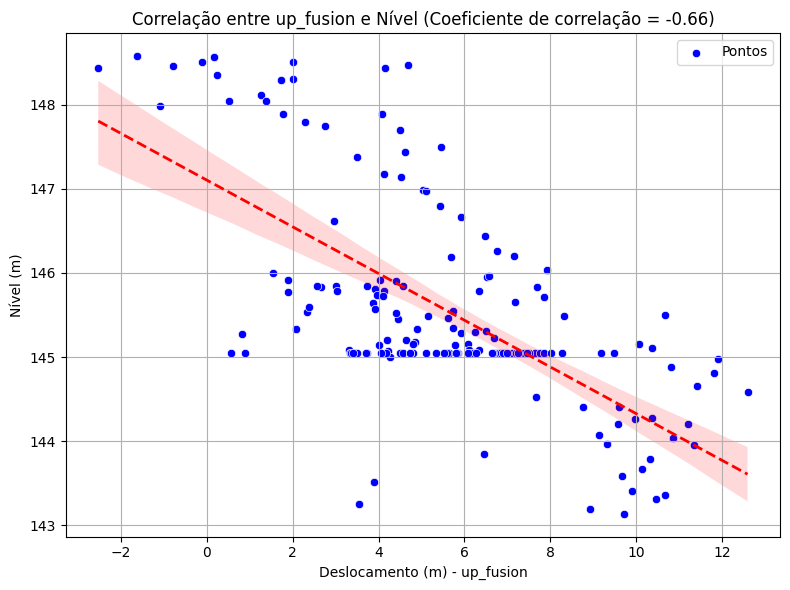

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Certifique-se de que as séries temporais de up_fusion e nivel tenham a mesma estrutura de datas
# Já temos 'nivel_data' que foi interpolado para as mesmas datas de 'up_fusion'
serie_up_fusion = up_fusion.loc[idx, colunas_temporais].astype(float)
nivel_data_values = nivel_data['nivel'].values

# Verifique se há valores NaN nas séries
print("Valores NaN em up_fusion:", serie_up_fusion.isna().sum())
print("Valores NaN em nivel_data:", pd.Series(nivel_data_values).isna().sum())

# Remover valores NaN (caso existam)
valid_data = ~np.isnan(serie_up_fusion) & ~np.isnan(nivel_data_values)
serie_up_fusion_clean = serie_up_fusion[valid_data]
nivel_data_values_clean = nivel_data_values[valid_data]

# Verifique novamente se há valores NaN
print("Valores NaN após limpeza:")
print("Valores NaN em up_fusion:", serie_up_fusion_clean.isna().sum())
print("Valores NaN em nivel_data:", pd.Series(nivel_data_values_clean).isna().sum())

# Calcular a correlação, se as séries não tiverem sido completamente limpas
if len(serie_up_fusion_clean) > 1:
    correlation = np.corrcoef(serie_up_fusion_clean, nivel_data_values_clean)[0, 1]
else:
    correlation = np.nan  # Se não houver dados suficientes para calcular a correlação

# Exibe a correlação
print(f"Coeficiente de correlação: {correlation}")

# Cria um gráfico de dispersão para visualizar a correlação
plt.figure(figsize=(8, 6))
sns.scatterplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, color="blue", label="Pontos")

# Adiciona uma linha de tendência (regressão linear)
sns.regplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, scatter=False, color="red", line_kws={"lw": 2, "ls": "--"})

# Título e rótulos do gráfico
plt.title(f'Correlação entre up_fusion e Nível (Coeficiente de correlação = {correlation:.2f})')
plt.xlabel('Deslocamento (m) - up_fusion')
plt.ylabel('Nível (m)')

# Exibe a grade e o gráfico
plt.grid(True)
plt.tight_layout()
plt.show()



C:\Users\tiago\AppData\Local\Temp\ipykernel_26744\387175974.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)


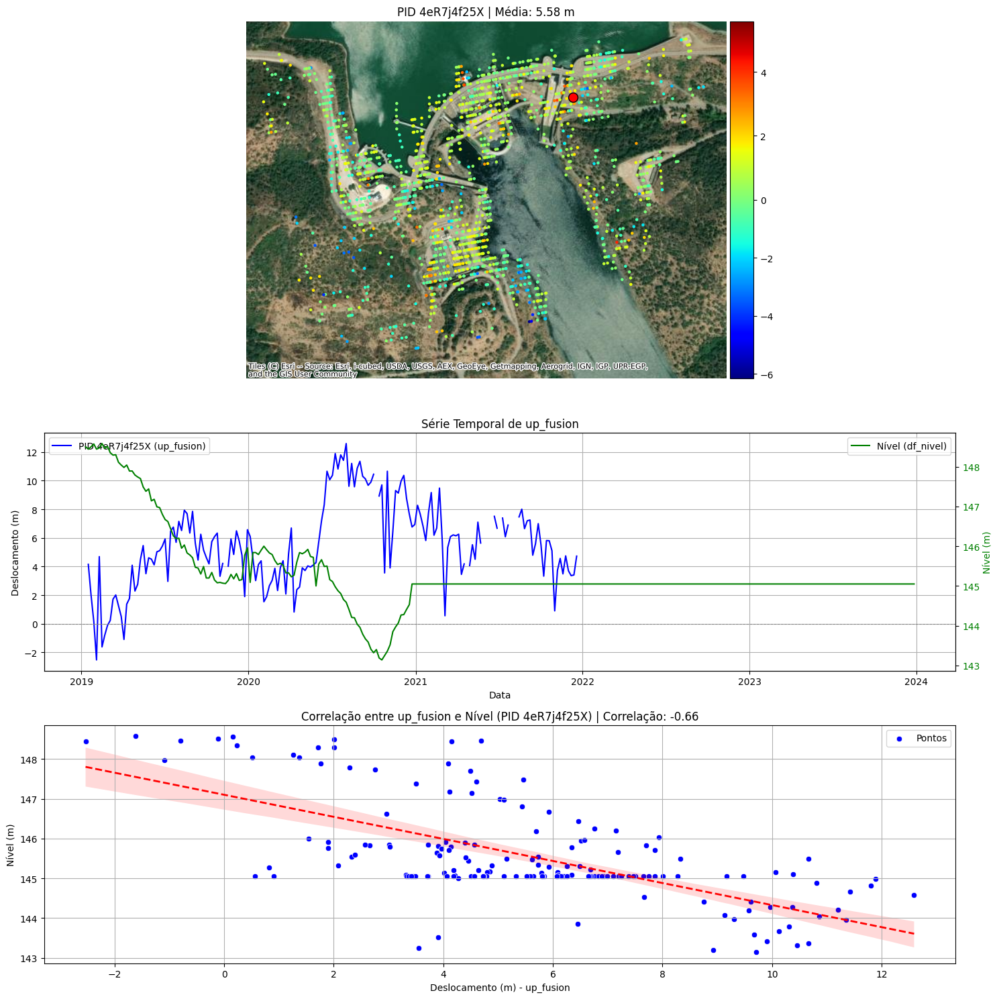

KeyError: 'data'

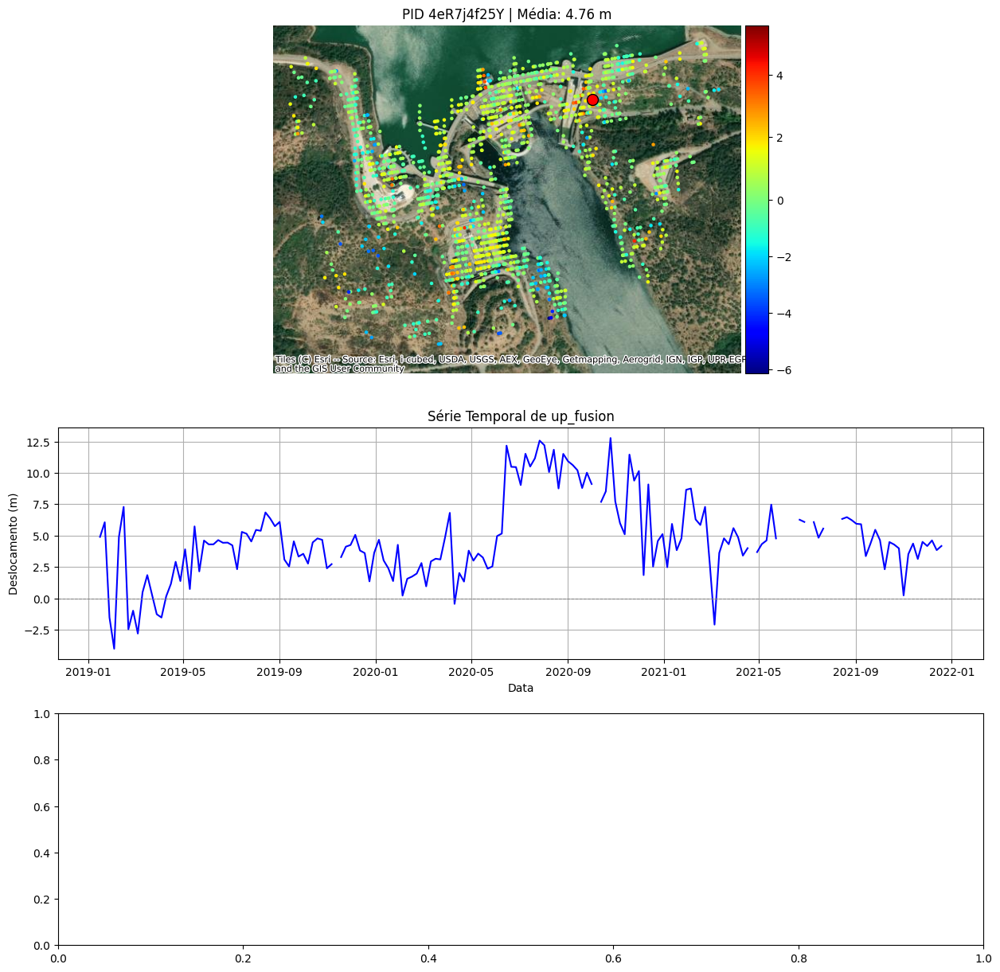

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns
import numpy as np

# ---------- CÁLCULO DA MÉDIA VERTICAL ----------
df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)

# Seleciona os 10 pontos com maior deslocamento vertical médio
top10 = df_asc.nlargest(10, "mean_up_fusion").copy()
top10_gdf = gpd.GeoDataFrame(
    top10,
    geometry=gpd.points_from_xy(top10.easting, top10.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# Colunas temporais e datas
colunas_temporais = [col for col in up_fusion.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# ---------- ESCALA DE CORES CONSISTENTE ----------
norm = colors.TwoSlopeNorm(
    vmin=df_asc["mean_up_fusion"].min(),
    vcenter=0,
    vmax=df_asc["mean_up_fusion"].max()
)

# ---------- Criar um GeoDataFrame para todos os pontos ----------
gdf_all = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# Encontrar os limites máximos para o mapa
xmin, ymin, xmax, ymax = gdf_all.total_bounds

# ---------- FIGURA COM SUBPLOTS ----------
# Ajuste o tamanho da figura
for i, (idx, row) in enumerate(top10.iterrows()):
    fig, axs = plt.subplots(3, 1, figsize=(15, 15), gridspec_kw={'height_ratios': [1.5, 1, 1]})
    
    # Mapa (primeiro subgráfico)
    ax_map = axs[0]
    divider = make_axes_locatable(ax_map)
    cax = divider.append_axes("right", size="5%", pad=0.05)

    gdf_all.plot(
        ax=ax_map,
        column="mean_up_fusion",
        cmap="jet",
        markersize=5,
        norm=norm,
        legend=True,
        cax=cax
    )
    gdf_row = top10_gdf.loc[[idx]]
    gdf_row.plot(
        ax=ax_map,
        color="red",
        edgecolor="black",
        markersize=100
    )
    ctx.add_basemap(ax_map, source=ctx.providers.Esri.WorldImagery)

    ax_map.set_xlim(xmin, xmax)
    ax_map.set_ylim(ymin, ymax)
    ax_map.set_title(f"PID {row['pid']} | Média: {row['mean_up_fusion']:.2f} m")
    ax_map.set_axis_off()

    # Série Temporal (segundo subgráfico)
    ax_series = axs[1]
    serie_up_fusion = up_fusion.loc[idx, colunas_temporais].astype(float)
    ax_series.plot(datas, serie_up_fusion, color="blue", label=f"PID {row['pid']} (up_fusion)")
    ax_series.axhline(0, color='gray', linestyle='--', linewidth=0.7)
    ax_series.set_title("Série Temporal de up_fusion")
    ax_series.set_ylabel("Deslocamento (m)")
    ax_series.set_xlabel("Data")
    ax_series.grid(True)

    # Série Temporal de Nível (usando eixo y secundário)
    df_nivel['data'] = pd.to_datetime(df_nivel['data'])
    df_nivel.set_index('data', inplace=True)
    nivel_data = df_nivel.reindex(datas, method='nearest')
    nivel_data_values = nivel_data.loc[datas, 'nivel'].values

    if len(nivel_data_values) > 0:
        ax2 = ax_series.twinx()  # Cria um segundo eixo y
        ax2.plot(datas, nivel_data_values, color="green", label="Nível (df_nivel)")
        ax2.set_ylabel("Nível (m)", color="green")
        ax2.tick_params(axis='y', labelcolor="green")
        ax_series.legend(loc='upper left')
        ax2.legend(loc='upper right')

    # Gráfico de Dispersão e Correlação (terceiro subgráfico)
    ax_corr = axs[2]
    valid_data = ~np.isnan(serie_up_fusion) & ~np.isnan(nivel_data_values)
    serie_up_fusion_clean = serie_up_fusion[valid_data]
    nivel_data_values_clean = nivel_data_values[valid_data]

    if len(serie_up_fusion_clean) > 1:
        correlation = np.corrcoef(serie_up_fusion_clean, nivel_data_values_clean)[0, 1]
    else:
        correlation = np.nan

    # Gráfico de dispersão
    sns.scatterplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, color="blue", ax=ax_corr, label="Pontos")
    sns.regplot(x=serie_up_fusion_clean, y=nivel_data_values_clean, scatter=False, color="red", ax=ax_corr, line_kws={"lw": 2, "ls": "--"})
    
    ax_corr.set_title(f"Correlação entre up_fusion e Nível (PID {row['pid']}) | Correlação: {correlation:.2f}")
    ax_corr.set_xlabel('Deslocamento (m) - up_fusion')
    ax_corr.set_ylabel('Nível (m)')
    ax_corr.grid(True)

    # Ajustes gerais
    plt.tight_layout()
    plt.show()



C:\Users\tiago\AppData\Local\Temp\ipykernel_26744\1646373645.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)


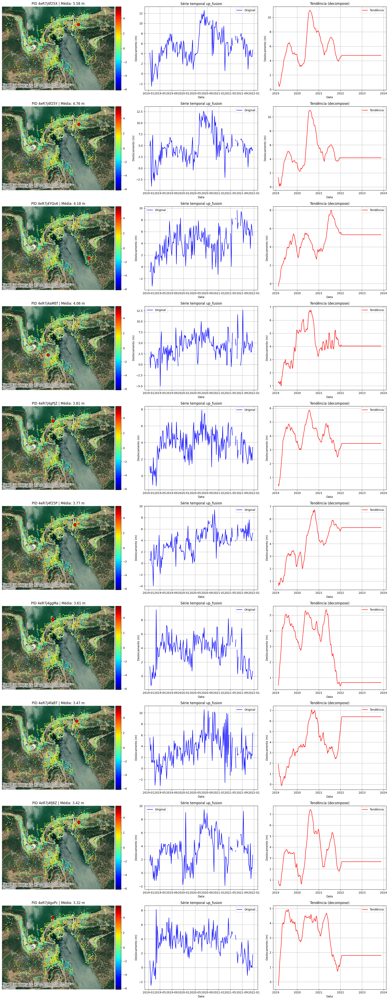

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable
from statsmodels.tsa.seasonal import seasonal_decompose

# ---------- CÁLCULO DA MÉDIA VERTICAL ----------
df_asc["mean_up_fusion"] = up_fusion.mean(axis=1)

# Seleciona os 10 pontos com maior deslocamento vertical médio
top10 = df_asc.nlargest(10, "mean_up_fusion").copy()
top10_gdf = gpd.GeoDataFrame(
    top10,
    geometry=gpd.points_from_xy(top10.easting, top10.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# Colunas temporais e datas
colunas_temporais = [col for col in up_fusion.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# ---------- ESCALA DE CORES CONSISTENTE ----------
norm = colors.TwoSlopeNorm(
    vmin=df_asc["mean_up_fusion"].min(),
    vcenter=0,
    vmax=df_asc["mean_up_fusion"].max()
)

# ---------- GeoDataFrame com todos os pontos ----------
gdf_all = gpd.GeoDataFrame(
    df_asc,
    geometry=gpd.points_from_xy(df_asc.easting, df_asc.northing),
    crs="EPSG:3035"
).to_crs(epsg=3857)

# Limites do mapa
xmin, ymin, xmax, ymax = gdf_all.total_bounds

# ---------- FIGURA COM SUBPLOTS ----------
fig, axs = plt.subplots(10, 3, figsize=(20, 50), gridspec_kw={'width_ratios': [1.2, 1, 1]})
fig.subplots_adjust(hspace=0.5, wspace=0.3)

for i, (idx, row) in enumerate(top10.iterrows()):
    gdf_row = top10_gdf.loc[[idx]]
    ax_map = axs[i, 0]
    ax_series = axs[i, 1]
    ax_trend = axs[i, 2]

    # --- Mapa ---
    divider = make_axes_locatable(ax_map)
    cax = divider.append_axes("right", size="5%", pad=0.05)

    gdf_all.plot(
        ax=ax_map,
        column="mean_up_fusion",
        cmap="jet",
        markersize=5,
        norm=norm,
        legend=True,
        cax=cax
    )
    gdf_row.plot(
        ax=ax_map,
        color="red",
        edgecolor="black",
        markersize=100
    )
    ctx.add_basemap(ax_map, source=ctx.providers.Esri.WorldImagery)
    ax_map.set_xlim(xmin, xmax)
    ax_map.set_ylim(ymin, ymax)
    ax_map.set_title(f"PID {row['pid']} | Média: {row['mean_up_fusion']:.2f} m")
    ax_map.set_axis_off()

    # --- Série temporal original ---
    serie = up_fusion.loc[idx, colunas_temporais].astype(float)
    serie.index = datas
    ax_series.plot(serie.index, serie.values, color="blue", label="Original")
    ax_series.axhline(0, color='gray', linestyle='--', linewidth=0.7)
    ax_series.set_title("Série temporal up_fusion")
    ax_series.set_ylabel("Deslocamento (m)")
    ax_series.set_xlabel("Data")
    ax_series.grid(True)
    ax_series.legend()

    # --- Decomposição temporal ---
    # Preencher possíveis NaNs
    serie_interp = serie.interpolate(method='linear', limit_direction='both')

    # Decomposição
    decomposition = seasonal_decompose(serie_interp, model='additive', period=12)

    # Plot da tendência
    ax_trend.plot(serie.index, decomposition.trend, color='red', label='Tendência')
    ax_trend.set_title("Tendência (decompose)")
    ax_trend.set_ylabel("Deslocamento (m)")
    ax_trend.set_xlabel("Data")
    ax_trend.grid(True)
    ax_trend.legend()

plt.tight_layout()
plt.show()




In [ ]:
# Definir os limites Alqueva
norte_min = 1855050
norte_max = 1855850
este_min = 2792250
este_max = 2793250

# Aplicar o filtro
df = df[
    (df['northing'] >= norte_min) & (df['northing'] <= norte_max) &
    (df['easting'] >= este_min) & (df['easting'] <= este_max)
]

df

,pid,easting,northing,height,rmse,mean_velocity,mean_velocity_std,acceleration,acceleration_std,seasonality,...,20231025,20231031,20231106,20231112,20231118,20231124,20231130,20231206,20231212,20231218
263331,40McjqvU5C,2792250,1855150,138.1,1.7,-0.2,0.1,0.02,0.11,1.0,...,1.2,2.9,3.7,1.8,-1.8,-2.5,-0.9,0.1,-0.3,-1.3
263332,40McoXajHG,2792250,1855250,149.1,1.9,-0.6,0.1,-0.76,0.14,0.5,...,-5.4,-4.3,-4.7,-6.4,-7.5,-8.6,-10.1,-10.3,-9.3,-9.0
263333,40MctEFyTK,2792250,1855350,183.6,2.1,-2.3,0.1,0.07,0.13,0.8,...,-9.1,-9.8,-10.3,-11.0,-11.4,-11.4,-12.2,-12.1,-10.8,-12.5
263334,40McxuvDfO,2792250,1855450,208.1,3.2,1.1,0.1,1.31,0.21,0.5,...,-2.3,0.6,1.8,0.5,-1.1,-1.3,-0.2,2.3,4.4,3.0
263335,40Md7IFi3W,2792250,1855650,205.9,2.7,-0.6,0.1,-0.88,0.17,0.6,...,-3.6,-2.6,-0.8,1.1,0.8,-1.1,-2.2,-2.1,-2.9,-5.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
266432,40Md2baSrb,2793150,1855550,146.6,2.1,-1.5,0.1,0.12,0.13,0.7,...,-8.4,-10.4,-12.7,-14.5,-13.1,-9.7,-8.8,-9.7,-10.0,-9.6
266720,40McfAGEtI,2793250,1855050,163.5,1.7,-1.8,0.1,0.00,0.11,0.3,...,-8.2,-9.0,-8.9,-8.2,-8.7,-10.3,-10.8,-9.9,-9.3,-10.0
266721,40McxuvDfY,2793250,1855450,150.0,1.5,-1.9,0.1,-0.03,0.09,0.2,...,-8.4,-7.5,-8.7,-11.3,-11.6,-10.4,-9.9,-9.9,-9.6,-9.5
266722,40Md2baSrc,2793250,1855550,155.4,2.9,-1.4,0.1,0.65,0.18,1.8,...,-1.3,-3.1,-3.6,-3.2,-4.7,-7.8,-7.7,-4.1,-2.3,-3.1


In [ ]:
s = df_asc.T
s.head(25)

,0,1,2,3,4,5,6,7,8,9,...,226435,226436,226437,226438,226439,226440,226441,226442,226443,226444
pid,4EM4h00p9W,4EM4h00H9R,4EM4h00H9S,4EM4h01NLc,4EM4h016Ks,4EM4h01NNu,4EM4h00HCp,4EM4h00YFr,4EM4h016MF,4EM4h01NPI,...,4EM4h6Wq8f,4EM4h6WZJH,4EM4h6WZJJ,4EM4h6WZJM,4EM4h6WqML,4EM4h6WqMM,4EM4h6WqMO,4EM4h6WZJz,4EM4h6WqN0,4EM4h6WZPC
mp_type,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
latitude,38.287821,38.290389,38.290388,38.289922,38.290941,38.290812,38.291701,38.291572,38.291418,38.291303,...,38.200516,38.205294,38.205299,38.205326,38.205177,38.205181,38.205202,38.205539,38.20542,38.20736
longitude,-7.313548,-7.329765,-7.329755,-7.330067,-7.336324,-7.336312,-7.338971,-7.338958,-7.339668,-7.339757,...,-8.028592,-8.062568,-8.062605,-8.0628,-8.06264,-8.062672,-8.062822,-8.064358,-8.064419,-8.077686
easting,2810422.31,2809092.57,2809093.37,2809056.21,2808543.82,2808541.95,2808334.49,2808332.71,2808268.48,2808258.26,...,2747288.23,2744496.74,2744493.69,2744477.59,2744487.84,2744485.21,2744472.87,2744349.51,2744341.53,2743253.41
northing,1861750.76,1862351.02,1862350.68,1862306.38,1862541.14,1862526.89,1862676.09,1862661.8,1862659.26,1862648.58,...,1866793.85,1868013.9,1868015.22,1868022.16,1868002.69,1868003.83,1868009.15,1868077.46,1868065.84,1868550.66
height,185.5,178.6,175.1,182.3,184.0,181.3,175.4,172.6,157.6,158.7,...,133.7,102.8,99.5,105.0,100.0,99.4,104.5,103.0,108.6,119.8
height_wgs84,240.7,233.8,230.3,237.5,239.2,236.5,230.6,227.8,212.8,213.9,...,188.6,157.7,154.4,159.9,154.9,154.3,159.4,157.9,163.5,174.7
line,3,1,1,5,4,5,1,2,4,5,...,1472,1471,1471,1471,1472,1472,1472,1471,1472,1471
pixel,26,397,398,400,542,542,607,607,627,628,...,15945,16791,16793,16796,16793,16794,16796,16835,16834,17158


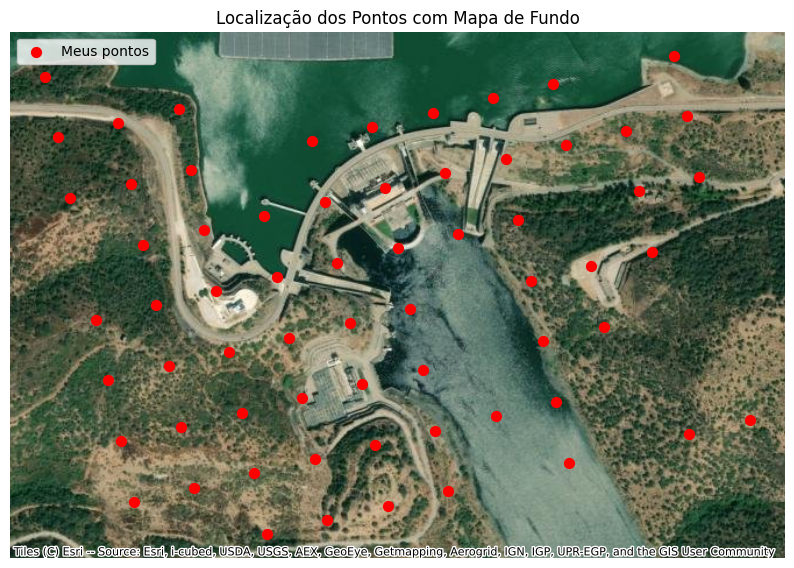

In [ ]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx

# Criar GeoDataFrame com EPSG:3035
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.easting, df.northing),
    crs="EPSG:3035"  # European LAEA projection
)

# Converter para Web Mercator para compatibilidade com o mapa de fundo
gdf_webmerc = gdf.to_crs(epsg=3857)

# Plot com mapa de fundo
fig, ax = plt.subplots(figsize=(10, 10))
gdf_webmerc.plot(ax=ax, color='red', markersize=50, label='Meus pontos')
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)
#ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)
ax.set_axis_off()
plt.legend()
plt.title("Localização dos Pontos com Mapa de Fundo")
plt.show()


C:\Users\tiago\AppData\Local\Temp\ipykernel_21772\945064271.py:27: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('jet')


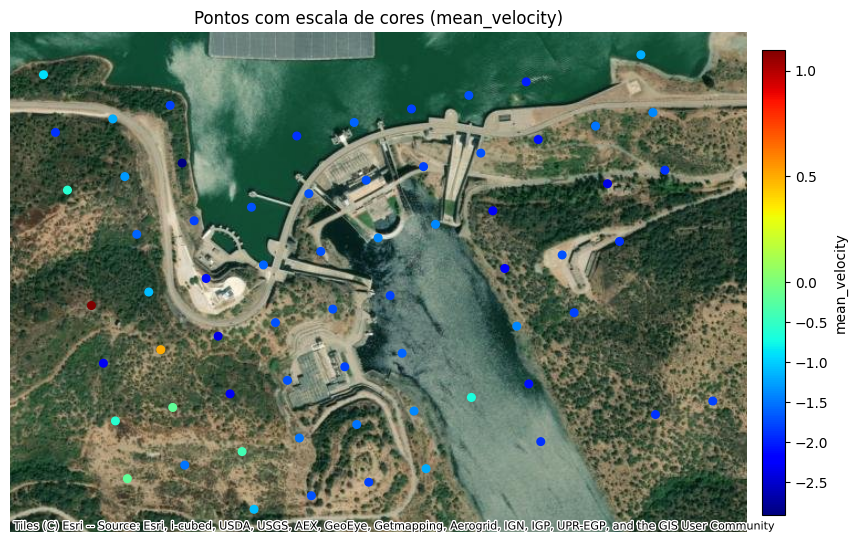

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
import geopandas as gpd

# Criar o GeoDataFrame com o CRS correto (ETRS89 / LAEA Europe)
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.easting, df.northing),
    crs="EPSG:3035"  # ou outro se souberes que não é este
)

# Converter para Web Mercator para usar no mapa
gdf_webmerc = gdf.to_crs(epsg=3857)

# Escolher a coluna para o valor
coluna_valor = "mean_velocity"

# Normalização das cores
norm = colors.TwoSlopeNorm(
    vmin=gdf[coluna_valor].min(),
    vcenter=0,
    vmax=gdf[coluna_valor].max()
)

# Colormap
cmap = plt.cm.get_cmap('jet')

# Criar figura
fig, ax = plt.subplots(figsize=(10, 10))
gdf_webmerc.plot(
    ax=ax,
    column=coluna_valor,
    cmap=cmap,
    markersize=30,
    norm=norm,
    legend=False
)

# Adicionar mapa de fundo
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)
ax.set_axis_off()
plt.title(f"Pontos com escala de cores ({coluna_valor})")

# Adicionar barra de cores
from matplotlib.cm import ScalarMappable
sm = ScalarMappable(cmap=cmap, norm=norm)
sm._A = []  # Forçar ScalarMappable a funcionar
cbar = plt.colorbar(sm, ax=ax, fraction=0.03, pad=0.02)
cbar.set_label(coluna_valor)

plt.show()



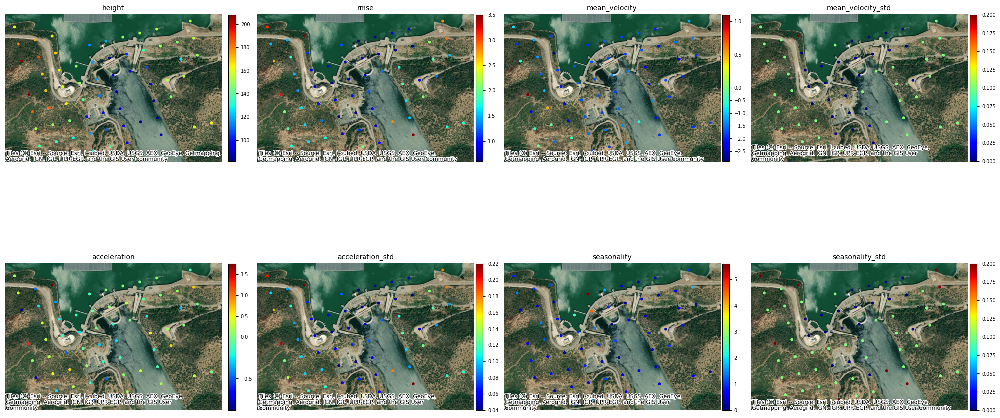

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
import geopandas as gpd

# --- Criar GeoDataFrame ---
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.easting, df.northing),
    crs="EPSG:3035"
)
gdf_webmerc = gdf.to_crs(epsg=3857)

# Variáveis a representar
variaveis = [
    "height",
    "rmse",
    "mean_velocity",
    "mean_velocity_std",
    "acceleration",
    "acceleration_std",
    "seasonality",
    "seasonality_std"
]

# Criar figura 4x2 (mais altura, mais espaço)
fig, axs = plt.subplots(2, 4, figsize=(20, 10), constrained_layout=True)
axs = axs.flatten()

for i, var in enumerate(variaveis):
    ax = axs[i]

    vmin = gdf_webmerc[var].min()
    vmax = gdf_webmerc[var].max()

    # Normalização de cores
    if vmin < 0 and vmax > 0:
        norm = colors.TwoSlopeNorm(vmin=vmin, vcenter=0, vmax=vmax)
    else:
        norm = colors.Normalize(vmin=vmin, vmax=vmax)

    # Plot principal
    gdf_webmerc.plot(
        ax=ax,
        column=var,
        cmap='jet',
        markersize=10,
        norm=norm,
        legend=False
    )
    ctx.add_basemap(ax, source=ctx.providers.Esri.WorldImagery)
    ax.set_title(var, fontsize=10)
    ax.set_axis_off()

    # Colorbar individual
    sm = plt.cm.ScalarMappable(cmap='jet', norm=norm)
    sm._A = []
    cbar = fig.colorbar(sm, ax=ax, shrink=0.6, pad=0.01)
    cbar.ax.tick_params(labelsize=7)

# Exibir
plt.show()



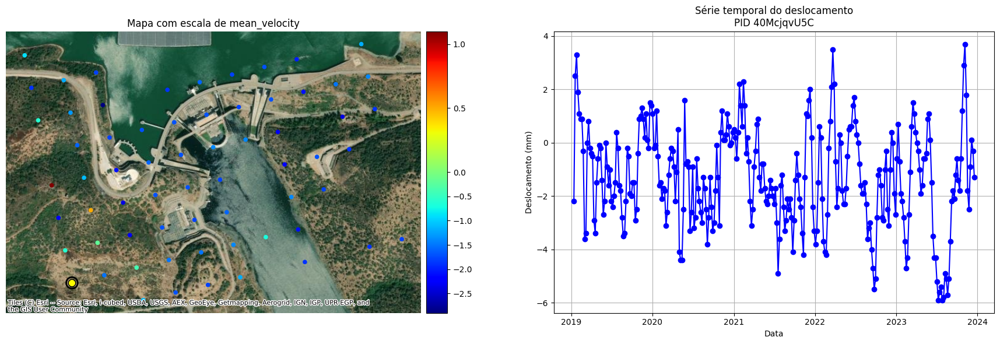

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable

# --- Criação do GeoDataFrame com coordenadas easting/northing ---
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.easting, df.northing),
    crs="EPSG:3035"
)
gdf_webmerc = gdf.to_crs(epsg=3857)

# Nome da variável e PID de interesse
variavel_cor = "mean_velocity"
pid_escolhido = '40McjqvU5C'  # Substitui se quiseres outro

# Isolar colunas temporais
colunas_temporais = [col for col in df.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# Verifica se o PID existe
linha_ponto = df[df["pid"] == pid_escolhido]
linha_ponto_geo = gdf_webmerc[gdf_webmerc["pid"] == pid_escolhido]

if linha_ponto.empty:
    print(f"PID {pid_escolhido} não encontrado!")
else:
    serie_temporal = linha_ponto[colunas_temporais].values.flatten().astype(float)

    # Normalização das cores
    norm = colors.TwoSlopeNorm(
        vmin=gdf_webmerc[variavel_cor].min(),
        vcenter=0,
        vmax=gdf_webmerc[variavel_cor].max()
    )

    # --- Criar figura com layout ajustado ---
    fig, axs = plt.subplots(1, 2, figsize=(18, 6), gridspec_kw={'width_ratios': [1.2, 1]})

    # --- Painel do mapa ---
    divider = make_axes_locatable(axs[0])
    cax = divider.append_axes("right", size="5%", pad=0.1)

    gdf_webmerc.plot(
        ax=axs[0],
        column=variavel_cor,
        cmap='jet',
        markersize=20,
        legend=True,
        norm=norm,
        cax=cax
    )
    ctx.add_basemap(axs[0], source=ctx.providers.Esri.WorldImagery)
    axs[0].set_title(f"Mapa com escala de {variavel_cor}")
    axs[0].set_axis_off()

    # Destacar ponto específico com círculo maior
    linha_ponto_geo.plot(
        ax=axs[0],
        color='none',
        edgecolor='black',
        linewidth=2,
        markersize=200,
        zorder=3
    )
    axs[0].scatter(
        linha_ponto_geo.geometry.x,
        linha_ponto_geo.geometry.y,
        color='yellow',
        s=80,
        zorder=4,
        edgecolor='black'
    )

    # --- Painel da série temporal ---
    axs[1].plot(datas, serie_temporal, marker='o', linestyle='-', color='blue')
    axs[1].set_title(f"Série temporal do deslocamento\nPID {pid_escolhido}")
    axs[1].set_xlabel("Data")
    axs[1].set_ylabel("Deslocamento (mm)")
    axs[1].grid(True)

    plt.tight_layout()
    plt.show()


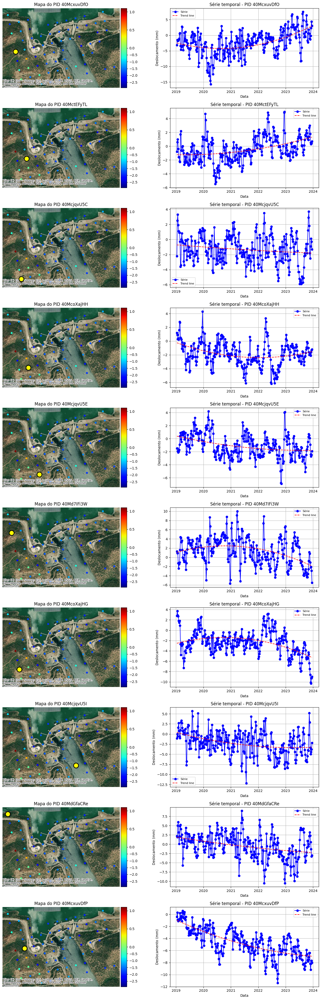

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np

# --- Criar GeoDataFrame ---
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.easting, df.northing),
    crs="EPSG:3035"
)
gdf_webmerc = gdf.to_crs(epsg=3857)

# --- Variáveis principais ---
variavel_cor = "mean_velocity"
colunas_temporais = [col for col in df.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# --- Selecionar os 10 pontos com maior mean_velocity ---
top10 = gdf_webmerc.sort_values(by=variavel_cor, ascending=False).head(10)

# --- Normalização da cor ---
norm = colors.TwoSlopeNorm(
    vmin=gdf_webmerc[variavel_cor].min(),
    vcenter=0,
    vmax=gdf_webmerc[variavel_cor].max()
)

# --- Criar figura ---
fig, axs = plt.subplots(nrows=10, ncols=2, figsize=(14, 40), gridspec_kw={'width_ratios': [1.2, 1]})

for i, (idx, linha) in enumerate(top10.iterrows()):
    ax_map = axs[i, 0]
    ax_plot = axs[i, 1]

    # --- Mapa ---
    divider = make_axes_locatable(ax_map)
    cax = divider.append_axes("right", size="5%", pad=0.05)

    gdf_webmerc.plot(
        ax=ax_map,
        column=variavel_cor,
        cmap='jet',
        markersize=20,
        norm=norm,
        cax=cax,
        legend=True
    )
    ctx.add_basemap(ax_map, source=ctx.providers.Esri.WorldImagery)
    ax_map.set_axis_off()
    ax_map.set_title(f"Mapa do PID {linha['pid']}")

    # Destacar o ponto
    ax_map.scatter(
        linha.geometry.x,
        linha.geometry.y,
        color='yellow',
        s=200,
        edgecolor='black',
        linewidth=2,
        zorder=4
    )

    # --- Série temporal ---
    serie = df.loc[df['pid'] == linha['pid'], colunas_temporais].values.flatten().astype(float)
    ax_plot.plot(datas, serie, marker='o', linestyle='-', color='blue', label='Série')

    # --- Trend line ---
    x = (datas - datas[0]).days  # dias desde o início (como base temporal)
    coeffs = np.polyfit(x, serie, deg=2)  # ajuste linear
    trend = np.poly1d(coeffs)(x)
    ax_plot.plot(datas, trend, color='red', linestyle='--', label='Trend line')

    ax_plot.set_title(f"Série temporal - PID {linha['pid']}")
    ax_plot.set_xlabel("Data")
    ax_plot.set_ylabel("Deslocamento (mm)")
    ax_plot.grid(True)
    ax_plot.legend(fontsize=8)

plt.tight_layout()
plt.show()



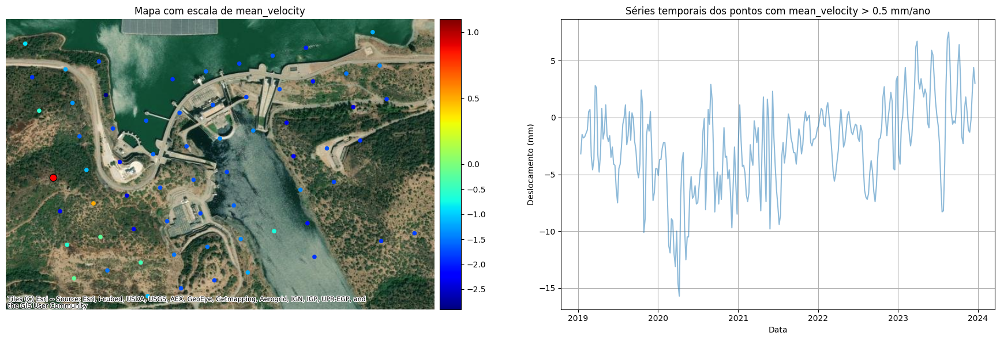

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable

# --- Criação do GeoDataFrame com coordenadas easting/northing ---
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.easting, df.northing),
    crs="EPSG:3035"  # CRS dos dados fornecidos
)
gdf_webmerc = gdf.to_crs(epsg=3857)  # Para compatibilidade com o basemap

# Nome da variável e limite
variavel_cor = "mean_velocity"
limite = 0.5

# Isolar colunas com datas (começam com "20")
colunas_temporais = [col for col in df.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# --- Filtrar os pontos para destacar ---
pontos_destacados = df[df[variavel_cor] > limite]
pontos_destaque = gdf_webmerc[gdf_webmerc[variavel_cor] > limite]

# Normalização das cores
norm = colors.TwoSlopeNorm(
    vmin=gdf_webmerc[variavel_cor].min(),
    vcenter=0,
    vmax=gdf_webmerc[variavel_cor].max()
)

# --- Criar figura com layout ajustado ---
fig, axs = plt.subplots(1, 2, figsize=(18, 6), gridspec_kw={'width_ratios': [1.2, 1]})

# --- Painel do mapa ---
divider = make_axes_locatable(axs[0])
cax = divider.append_axes("right", size="5%", pad=0.1)

gdf_webmerc.plot(
    ax=axs[0],
    column=variavel_cor,
    cmap='jet',
    markersize=20,
    legend=True,
    norm=norm,
    cax=cax
)
ctx.add_basemap(axs[0], source=ctx.providers.Esri.WorldImagery)
axs[0].set_title(f"Mapa com escala de {variavel_cor}")
axs[0].set_axis_off()

# --- Destacar pontos acima do limite ---
pontos_destaque.plot(
    ax=axs[0],
    facecolor='red',
    edgecolor='black',
    markersize=80,
    linewidth=1,
    label=f"{variavel_cor} > {limite} mm/ano"
)

# --- Painel da série temporal ---
for idx, row in pontos_destacados.iterrows():
    serie = row[colunas_temporais].values.astype(float)
    axs[1].plot(datas, serie, alpha=0.5)

axs[1].set_title(f"Séries temporais dos pontos com {variavel_cor} > {limite} mm/ano")
axs[1].set_xlabel("Data")
axs[1].set_ylabel("Deslocamento (mm)")
axs[1].grid(True)

plt.tight_layout()
plt.show()

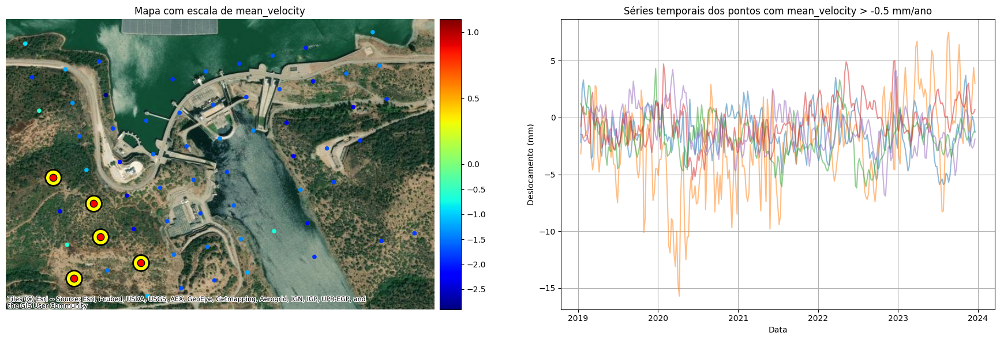

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable

# --- Criação do GeoDataFrame com coordenadas easting/northing ---
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.easting, df.northing),
    crs="EPSG:3035"  # CRS dos dados fornecidos
)
gdf_webmerc = gdf.to_crs(epsg=3857)  # Para compatibilidade com o basemap

# Nome da variável e limite
variavel_cor = "mean_velocity"
limite = -0.5

# Isolar colunas com datas (começam com "20")
colunas_temporais = [col for col in df.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# --- Filtrar os pontos para destacar ---
pontos_destacados = df[df[variavel_cor] > limite]
pontos_destaque = gdf_webmerc[gdf_webmerc[variavel_cor] > limite]

# Normalização das cores
norm = colors.TwoSlopeNorm(
    vmin=gdf_webmerc[variavel_cor].min(),
    vcenter=0,
    vmax=gdf_webmerc[variavel_cor].max()
)

# --- Criar figura com layout ajustado ---
fig, axs = plt.subplots(1, 2, figsize=(18, 6), gridspec_kw={'width_ratios': [1.2, 1]})

# --- Painel do mapa ---
divider = make_axes_locatable(axs[0])
cax = divider.append_axes("right", size="5%", pad=0.1)

gdf_webmerc.plot(
    ax=axs[0],
    column=variavel_cor,
    cmap='jet',
    markersize=20,
    legend=True,
    norm=norm,
    cax=cax
)
ctx.add_basemap(axs[0], source=ctx.providers.Esri.WorldImagery)
axs[0].set_title(f"Mapa com escala de {variavel_cor}")
axs[0].set_axis_off()

# --- Destacar todos os pontos acima do limite com círculos maiores ---
for idx, ponto in pontos_destaque.iterrows():
    x, y = ponto.geometry.x, ponto.geometry.y
    axs[0].scatter(x, y, color='yellow', s=400, edgecolor='black', linewidth=2)

# --- Destacar o ponto original (ponto com marcador menor) ---
pontos_destaque.plot(
    ax=axs[0],
    facecolor='red',
    edgecolor='black',
    markersize=80,
    linewidth=1,
    label=f"{variavel_cor} > {limite} mm/ano"
)

# --- Painel da série temporal ---
for idx, row in pontos_destacados.iterrows():
    serie = row[colunas_temporais].values.astype(float)
    axs[1].plot(datas, serie, alpha=0.5)

axs[1].set_title(f"Séries temporais dos pontos com {variavel_cor} > {limite} mm/ano")
axs[1].set_xlabel("Data")
axs[1].set_ylabel("Deslocamento (mm)")
axs[1].grid(True)

# Ajuste no layout para garantir que tudo caiba bem
plt.tight_layout()
plt.show()



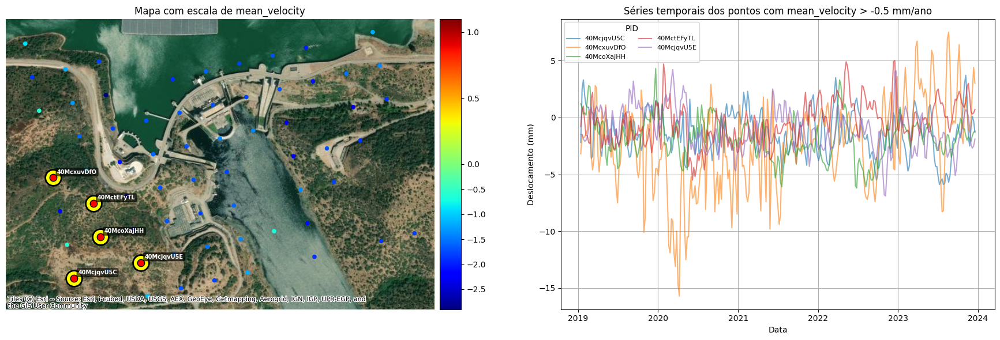

In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as ctx
from mpl_toolkits.axes_grid1 import make_axes_locatable

# --- Criação do GeoDataFrame com coordenadas easting/northing ---
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df.easting, df.northing),
    crs="EPSG:3035"
)
gdf_webmerc = gdf.to_crs(epsg=3857)

# Nome da variável e limite
variavel_cor = "mean_velocity"
limite = -0.5

# Colunas temporais (as que começam por "20")
colunas_temporais = [col for col in df.columns if col.startswith("20")]
datas = pd.to_datetime(colunas_temporais)

# Filtrar os pontos a destacar
pontos_destacados = df[df[variavel_cor] > limite]
pontos_destaque = gdf_webmerc[gdf_webmerc[variavel_cor] > limite]

# Normalização da cor
norm = colors.TwoSlopeNorm(
    vmin=gdf_webmerc[variavel_cor].min(),
    vcenter=0,
    vmax=gdf_webmerc[variavel_cor].max()
)

# Criar figura
fig, axs = plt.subplots(1, 2, figsize=(18, 6), gridspec_kw={'width_ratios': [1.2, 1]})

# --- Painel do mapa ---
divider = make_axes_locatable(axs[0])
cax = divider.append_axes("right", size="5%", pad=0.1)

gdf_webmerc.plot(
    ax=axs[0],
    column=variavel_cor,
    cmap='jet',
    markersize=20,
    legend=True,
    norm=norm,
    cax=cax
)
ctx.add_basemap(axs[0], source=ctx.providers.Esri.WorldImagery)
axs[0].set_title(f"Mapa com escala de {variavel_cor}")
axs[0].set_axis_off()

# --- Destacar os pontos com círculos e legendas com PID ---
for idx, ponto in pontos_destaque.iterrows():
    x, y = ponto.geometry.x, ponto.geometry.y
    axs[0].scatter(x, y, color='yellow', s=400, edgecolor='black', linewidth=2)
    axs[0].annotate(
        texto := ponto["pid"],
        (x, y),
        textcoords="offset points",
        xytext=(5, 5),
        fontsize=7,
        color='white',
        weight='bold',
        bbox=dict(boxstyle="round,pad=0.2", fc="black", alpha=0.6)
    )

# --- Reforçar os pontos destacados em vermelho ---
pontos_destaque.plot(
    ax=axs[0],
    facecolor='red',
    edgecolor='black',
    markersize=80,
    linewidth=1,
    label=f"{variavel_cor} > {limite} mm/ano"
)

# --- Painel da série temporal ---
for idx, row in pontos_destacados.iterrows():
    serie = row[colunas_temporais].values.astype(float)
    pid = row["pid"]
    axs[1].plot(datas, serie, alpha=0.6, label=pid)  # Adiciona label com o PID

axs[1].set_title(f"Séries temporais dos pontos com {variavel_cor} > {limite} mm/ano")
axs[1].set_xlabel("Data")
axs[1].set_ylabel("Deslocamento (mm)")
axs[1].grid(True)

# Mostrar legenda (com número limitado para não sobrecarregar)
axs[1].legend(loc="best", fontsize=8, ncol=2, title="PID")

plt.tight_layout()
plt.show()


In [ ]:
import folium
import pandas as pd

# Dados dos teus pontos
#df = pd.read_csv("data/meus_pontos.csv")

# Centro do mapa
mapa = folium.Map(location=[df['easting'].mean(), df['northing'].mean()], zoom_start=12)

# Adiciona cada ponto
for _, row in df.iterrows():
    folium.Marker(
        location=[row['easting'], row['northing']],
        popup=f"Ponto: {row['nome'] if 'nome' in row else ''}"
    ).add_to(mapa)

# Mostrar (num Jupyter Notebook aparece diretamente)
mapa.save("meu_mapa.html")

In [ ]:
import folium
from folium.plugins import MarkerCluster

# Converter para lat/lon para o mapa (Folium exige EPSG:4326)
gdf_latlon = gdf.to_crs(epsg=4326)

# Criar mapa centrado nos dados
centro = [gdf_latlon.geometry.y.mean(), gdf_latlon.geometry.x.mean()]
m = folium.Map(location=centro, zoom_start=10, tiles='Esri.WorldImagery')

# Cluster para os pontos
marker_cluster = MarkerCluster().add_to(m)

# Colormap simples (poderíamos fazer algo mais customizado com branca ou branca-colormap)
for idx, row in gdf_latlon.iterrows():
    valor = row[variavel_cor]
    cor = 'red' if valor > limite else 'blue'
    popup_text = f"PID: {row['pid']}<br>{variavel_cor}: {valor:.2f} mm/ano"
    
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=6,
        color='black',
        fill=True,
        fill_color=cor,
        fill_opacity=0.7,
        popup=folium.Popup(popup_text, max_width=200)
    ).add_to(marker_cluster)

# Mostrar
m.save("mapa_folium.html")
